In [1]:
import re
import pandas as pd
from time import time
from collections import defaultdict
import json

import spacy as spacy

import logging
logging.basicConfig(format="%(levelname)s - %(asctime)s: %(message)s", datefmt= '%H:%M:%S', level=logging.INFO)

In [33]:
df = pd.read_csv('../datasets/UnfairClauseClassifierDataset.csv')
df.shape

(9414, 14)

In [3]:
df.head()

,Id,Service Name,Sentences,Labels,Arbitration,Unilateral_Change,Content_Removal,Jurisdiction,Choice_Of_Law,Limitation_Of_Liability,Unilateral_Termination,Contract_By_Using,Postags,Trees
0,0,9gag,* accepting the terms of service,-1,-1,-1,-1,-1,-1,-1,-1,-1,SYM VBG DT NNS IN NNP,(ROOT (X (X (SYM *)) (NP (NP (VBG Accepting)) ...
1,1,9gag,"the purpose of this website , 9gag .",-1,-1,-1,-1,-1,-1,-1,-1,-1,"DT NN IN DT NN , NN .",(ROOT (NP (NP (DT The) (NN purpose)) (PP (IN o...
2,2,9gag,"com -lrb- the `` site '' -rrb- , owned and ope...",-1,-1,-1,-1,-1,-1,-1,-1,-1,"NN -LRB- DT `` NN '' -RRB- , VBN CC VBN IN NN ...",(ROOT (S (NP (NP (NP (NN com)) (-LRB- -LRB-) (...
3,3,9gag,please read these terms of service -lrb- `` ag...,-1,-1,-1,-1,-1,-1,-1,-1,-1,VB VB DT NNS IN NN -LRB- `` NN '' -RRB- RB IN ...,(ROOT (S (VP (VB Please) (VP (VB read) (NP (NP...
4,4,9gag,"by using or accessing the services , you agree...",1,-1,-1,-1,-1,-1,-1,-1,1,"IN VBG CC VBG DT NNPS , PRP VBP TO VB VBN IN P...",(ROOT (S (PP (IN By) (S (VP (VBG using) (CC or...


In [4]:
df.isnull().sum()

Id                         0
Service Name               0
Sentences                  0
Labels                     0
Arbitration                0
Unilateral_Change          0
Content_Removal            0
Jurisdiction               0
Choice_Of_Law              0
Limitation_Of_Liability    0
Unilateral_Termination     0
Contract_By_Using          0
Postags                    0
Trees                      0
dtype: int64

In [5]:
nlp = spacy.load('en_core_web_sm', disable=['ner', 'parser'])

def cleaning(doc):
    txt = [token.lemma_ for token in doc if not token.is_stop]
    if len(txt) > 2:
        return ' '.join(txt)

brief_cleaning = (re.sub("[^A-Za-z]+", ' ', str(row)).lower() for row in df['Sentences'])
t = time()
txt = [cleaning(doc) for doc in nlp.pipe(brief_cleaning, batch_size=5000, n_threads=-1)]
print('Time taken to cleanup everything: {} mins'.format(round((time() - t)/60, 2)))

Time taken to cleanup everything: 0.41 mins


In [6]:
df_clean = pd.DataFrame({'clean': txt})
df_clean = df_clean.dropna().drop_duplicates()
df_clean.shape

(9048, 1)

In [7]:
df_clean.head()

,clean
0,accept term service
1,purpose website gag
2,com lrb site rrb own operate gag inc provide w...
3,read term service lrb agreement rrb carefully ...
4,access service agree bind term condition agree...


In [8]:
from gensim.models.phrases import Phrases, Phraser

INFO - 13:44:45: 'pattern' package not found; tag filters are not available for English


In [9]:
sent = [row.split() for row in df_clean['clean']]

In [10]:
sent

[['accept', 'term', 'service'],
 ['purpose', 'website', 'gag'],
 ['com',
  'lrb',
  'site',
  'rrb',
  'own',
  'operate',
  'gag',
  'inc',
  'provide',
  'web',
  'publishing',
  'service'],
 ['read',
  'term',
  'service',
  'lrb',
  'agreement',
  'rrb',
  'carefully',
  'site',
  'service',
  'provide',
  'site',
  'lrb',
  'collectively',
  'service',
  'rrb'],
 ['access', 'service', 'agree', 'bind', 'term', 'condition', 'agreement'],
 ['agree', 'term', 'condition', 'agreement', 'use', 'service'],
 ['service',
  'access',
  'lrb',
  'subscriber',
  'rrb',
  'follow',
  'term',
  'condition'],
 ['subject',
  'term',
  'condition',
  'agreement',
  'gag',
  'inc',
  'offer',
  'provide',
  'service',
  'describe',
  'fully',
  'site',
  'select',
  'subscriber',
  'solely',
  'subscriber',
  's',
  'use',
  'use',
  'benefit',
  'party'],
 ['service',
  'shall',
  'include',
  'limit',
  'services',
  'gag',
  'inc',
  'perform',
  'subscriber',
  'offering',
  'content',
  'lrb',


In [11]:
phrases = Phrases(sent, min_count=30, progress_per=1000)

INFO - 13:44:46: collecting all words and their counts
INFO - 13:44:46: PROGRESS: at sentence #0, processed 0 words and 0 word types
INFO - 13:44:46: PROGRESS: at sentence #1000, processed 16184 words and 10932 word types
INFO - 13:44:46: PROGRESS: at sentence #2000, processed 31255 words and 19594 word types
INFO - 13:44:46: PROGRESS: at sentence #3000, processed 45231 words and 25990 word types
INFO - 13:44:46: PROGRESS: at sentence #4000, processed 60212 words and 32327 word types
INFO - 13:44:46: PROGRESS: at sentence #5000, processed 74267 words and 38126 word types
INFO - 13:44:46: PROGRESS: at sentence #6000, processed 89775 words and 43596 word types
INFO - 13:44:46: PROGRESS: at sentence #7000, processed 104305 words and 48656 word types
INFO - 13:44:46: PROGRESS: at sentence #8000, processed 119800 words and 54234 word types
INFO - 13:44:46: PROGRESS: at sentence #9000, processed 135514 words and 59327 word types
INFO - 13:44:46: collected 59515 word types from a corpus of 13

In [12]:
phrases

In [13]:
bigram = Phraser(phrases)

INFO - 13:44:46: source_vocab length 59515
INFO - 13:44:47: Phraser built with 91 phrasegrams


In [14]:
sentences = bigram[sent]

In [15]:
sentences

In [16]:
word_freq = defaultdict(int)
for sent in sentences:
    for i in sent:
        word_freq[i] += 1
        print(sent)
len(word_freq)

['accept', 'term', 'service']
['accept', 'term', 'service']
['accept', 'term', 'service']
['purpose', 'website', 'gag']
['purpose', 'website', 'gag']
['purpose', 'website', 'gag']
['com', 'lrb', 'site', 'rrb', 'own', 'operate', 'gag_inc', 'provide', 'web', 'publishing', 'service']
['com', 'lrb', 'site', 'rrb', 'own', 'operate', 'gag_inc', 'provide', 'web', 'publishing', 'service']
['com', 'lrb', 'site', 'rrb', 'own', 'operate', 'gag_inc', 'provide', 'web', 'publishing', 'service']
['com', 'lrb', 'site', 'rrb', 'own', 'operate', 'gag_inc', 'provide', 'web', 'publishing', 'service']
['com', 'lrb', 'site', 'rrb', 'own', 'operate', 'gag_inc', 'provide', 'web', 'publishing', 'service']
['com', 'lrb', 'site', 'rrb', 'own', 'operate', 'gag_inc', 'provide', 'web', 'publishing', 'service']
['com', 'lrb', 'site', 'rrb', 'own', 'operate', 'gag_inc', 'provide', 'web', 'publishing', 'service']
['com', 'lrb', 'site', 'rrb', 'own', 'operate', 'gag_inc', 'provide', 'web', 'publishing', 'service']
['co

['subscriber', 'shall', 'responsible', 'maintain', 'confidentiality', 'subscriber', 's', 'gag_inc', 'password']
['subscriber', 'shall', 'responsible', 'maintain', 'confidentiality', 'subscriber', 's', 'gag_inc', 'password']
['subscriber', 'shall', 'responsible', 'maintain', 'confidentiality', 'subscriber', 's', 'gag_inc', 'password']
['subscriber', 'shall', 'responsible', 'maintain', 'confidentiality', 'subscriber', 's', 'gag_inc', 'password']
['subscriber', 'shall', 'responsible', 'maintain', 'confidentiality', 'subscriber', 's', 'gag_inc', 'password']
['subscriber', 'shall', 'responsible', 'maintain', 'confidentiality', 'subscriber', 's', 'gag_inc', 'password']
['subscriber', 'shall', 'responsible', 'maintain', 'confidentiality', 'subscriber', 's', 'gag_inc', 'password']
['subscriber', 'solely_responsible', 'use', 'action', 'take', 'subscriber', 's', 'password', 'accept', 'responsibility', 'activity', 'conduct', 'subscriber', 's', 'account', 'agree', 'release', 'site', 'gag_inc', 'li

['academia_edu', 'content', 'mean', 'content', 'academia_edu', 'make', 'available', 'site', 'service', 'include', 'content', 'license', 'party', 'exclude', 'member', 'content']
['academia_edu', 'content', 'mean', 'content', 'academia_edu', 'make', 'available', 'site', 'service', 'include', 'content', 'license', 'party', 'exclude', 'member', 'content']
['academia_edu', 'content', 'mean', 'content', 'academia_edu', 'make', 'available', 'site', 'service', 'include', 'content', 'license', 'party', 'exclude', 'member', 'content']
['academia_edu', 'content', 'mean', 'content', 'academia_edu', 'make', 'available', 'site', 'service', 'include', 'content', 'license', 'party', 'exclude', 'member', 'content']
['academia_edu', 'content', 'mean', 'content', 'academia_edu', 'make', 'available', 'site', 'service', 'include', 'content', 'license', 'party', 'exclude', 'member', 'content']
['academia_edu', 'content', 'mean', 'content', 'academia_edu', 'make', 'available', 'site', 'service', 'include', '

['use', 'bot', 'automate', 'method', 'access', 'service', 'add', 'download', 'contact', 'profile', 'information']
['use', 'bot', 'automate', 'method', 'access', 'service', 'add', 'download', 'contact', 'profile', 'information']
['send', 'unsolicited', 'unauthorized', 'advertising', 'promotional', 'material', 'email', 'junk', 'mail', 'spam', 'chain', 'letter', 'form', 'solicitation']
['send', 'unsolicited', 'unauthorized', 'advertising', 'promotional', 'material', 'email', 'junk', 'mail', 'spam', 'chain', 'letter', 'form', 'solicitation']
['send', 'unsolicited', 'unauthorized', 'advertising', 'promotional', 'material', 'email', 'junk', 'mail', 'spam', 'chain', 'letter', 'form', 'solicitation']
['send', 'unsolicited', 'unauthorized', 'advertising', 'promotional', 'material', 'email', 'junk', 'mail', 'spam', 'chain', 'letter', 'form', 'solicitation']
['send', 'unsolicited', 'unauthorized', 'advertising', 'promotional', 'material', 'email', 'junk', 'mail', 'spam', 'chain', 'letter', 'form'

['verified', 'image', 'lrb', 'define', 'rrb', 'intend', 'indicate', 'photographic', 'representation', 'listing', 'time', 'photograph', 'take', 'endorsement', 'airbnb', 'host', 'listing']
['verified', 'image', 'lrb', 'define', 'rrb', 'intend', 'indicate', 'photographic', 'representation', 'listing', 'time', 'photograph', 'take', 'endorsement', 'airbnb', 'host', 'listing']
['verified', 'image', 'lrb', 'define', 'rrb', 'intend', 'indicate', 'photographic', 'representation', 'listing', 'time', 'photograph', 'take', 'endorsement', 'airbnb', 'host', 'listing']
['verified', 'image', 'lrb', 'define', 'rrb', 'intend', 'indicate', 'photographic', 'representation', 'listing', 'time', 'photograph', 'take', 'endorsement', 'airbnb', 'host', 'listing']
['verified', 'image', 'lrb', 'define', 'rrb', 'intend', 'indicate', 'photographic', 'representation', 'listing', 'time', 'photograph', 'take', 'endorsement', 'airbnb', 'host', 'listing']
['verified', 'image', 'lrb', 'define', 'rrb', 'intend', 'indicate

['airbnb', 'use', 'commercially', 'reasonable', 'effort', 'address', 'host', 'request', 'claim', 'relate', 'security', 'deposit', 'airbnb', 'responsible', 'administer', 'accept', 'claim', 'host', 'relate', 'security', 'deposit']
['represent_warrant', 'list', 'post', 'booking', 'guest', 's', 'stay', 'accommodation', 'lrb', 'rrb', 'breach', 'agreement', 'enter', 'party', 'homeowners', 'association', 'condominium', 'agreement', 'lrb_ii', 'rrb', 'comply', 'applicable_law', 'lrb', 'zone', 'law', 'rrb', 'tax', 'requirement', 'rule', 'regulation', 'lrb', 'include', 'have', 'require', 'permit', 'license', 'registration', 'rrb']
['represent_warrant', 'list', 'post', 'booking', 'guest', 's', 'stay', 'accommodation', 'lrb', 'rrb', 'breach', 'agreement', 'enter', 'party', 'homeowners', 'association', 'condominium', 'agreement', 'lrb_ii', 'rrb', 'comply', 'applicable_law', 'lrb', 'zone', 'law', 'rrb', 'tax', 'requirement', 'rule', 'regulation', 'lrb', 'include', 'have', 'require', 'permit', 'licens

['agree', 'pay', 'host', 'airbnb', 'determine', 'sole_discretion', 'responsible', 'damage', 'claim', 'airbnb', 'payment', 'collect', 'sum', 'security', 'deposit', 'lrb', 'applicable', 'rrb', 'require', 'cover', 'damage', 'claim', 'pursuant', 'payment', 'term']
['agree', 'pay', 'host', 'airbnb', 'determine', 'sole_discretion', 'responsible', 'damage', 'claim', 'airbnb', 'payment', 'collect', 'sum', 'security', 'deposit', 'lrb', 'applicable', 'rrb', 'require', 'cover', 'damage', 'claim', 'pursuant', 'payment', 'term']
['agree', 'pay', 'host', 'airbnb', 'determine', 'sole_discretion', 'responsible', 'damage', 'claim', 'airbnb', 'payment', 'collect', 'sum', 'security', 'deposit', 'lrb', 'applicable', 'rrb', 'require', 'cover', 'damage', 'claim', 'pursuant', 'payment', 'term']
['agree', 'pay', 'host', 'airbnb', 'determine', 'sole_discretion', 'responsible', 'damage', 'claim', 'airbnb', 'payment', 'collect', 'sum', 'security', 'deposit', 'lrb', 'applicable', 'rrb', 'require', 'cover', 'damag

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['sign', 'dropbox', 'account', 'email_address', 'provision', 'organization', 'organization', 'able', 'block', 'use', 'dropbox', 'transition', 'account', 'dropbox', 'team', 'lrb', 'e_g', 'dropbox', 'business', 'plan', 'dropbox', 'education', 'rrb', 'associate', 'dropbox', 'account', 'personal', 'email_address']
['sign', 'dropbox', 'account', 'email_address', 'provision', 'organization', 'organization', 'able', 'block', 'use', 'dropbox', 'transition', 'account', 'dropbox', 'team', 'lrb', 'e_g', 'dropbox', 'business', 'plan', 'dropbox', 'education', 'rrb', 'associate', 'dropbox', 'account', 'personal', 'email_address']
['sign', 'dropbox', 'account', 'email_address', 'provision', 'organization', 'organization', 'able', 'block', 'use', 'dropbox', 'transition', 'account', 'dropbox', 'team', 'lrb', 'e_g', 'dropbox', 'business', 'plan', 'dropbox', 'education', 'rrb', 'associate', 'dropbox', 'account', 'personal', 'email_address']
['sign', 'dropbox', 'account', 'email_address', 'provision', 'o

['service', 'allow', 'user', 'access', 'use', 'variety', 'educational', 'service', 'include', 'learn', 'practice', 'language', 'take', 'examination', 'duolingo', 'english', 'test', 'create', 'view', 'flashcard', 'tinycard', 'app']
['service', 'allow', 'user', 'access', 'use', 'variety', 'educational', 'service', 'include', 'learn', 'practice', 'language', 'take', 'examination', 'duolingo', 'english', 'test', 'create', 'view', 'flashcard', 'tinycard', 'app']
['duolingo', 'sole_discretion', 'time', 'update', 'change', 'suspend', 'improvement', 'discontinue', 'aspect', 'service', 'temporarily', 'permanently']
['duolingo', 'sole_discretion', 'time', 'update', 'change', 'suspend', 'improvement', 'discontinue', 'aspect', 'service', 'temporarily', 'permanently']
['duolingo', 'sole_discretion', 'time', 'update', 'change', 'suspend', 'improvement', 'discontinue', 'aspect', 'service', 'temporarily', 'permanently']
['duolingo', 'sole_discretion', 'time', 'update', 'change', 'suspend', 'improvemen

['duolingo', 'manage', 'regulate', 'control', 'modify', 'eliminate', 'virtual_item', 'time', 'notice']
['duolingo', 'manage', 'regulate', 'control', 'modify', 'eliminate', 'virtual_item', 'time', 'notice']
['duolingo', 'manage', 'regulate', 'control', 'modify', 'eliminate', 'virtual_item', 'time', 'notice']
['duolingo', 'manage', 'regulate', 'control', 'modify', 'eliminate', 'virtual_item', 'time', 'notice']
['duolingo', 'update', 'pricing', 'virtual_item', 'time', 'sole_discretion', 'add', 'new', 'virtual_item', 'additional', 'fee']
['duolingo', 'update', 'pricing', 'virtual_item', 'time', 'sole_discretion', 'add', 'new', 'virtual_item', 'additional', 'fee']
['duolingo', 'update', 'pricing', 'virtual_item', 'time', 'sole_discretion', 'add', 'new', 'virtual_item', 'additional', 'fee']
['duolingo', 'update', 'pricing', 'virtual_item', 'time', 'sole_discretion', 'add', 'new', 'virtual_item', 'additional', 'fee']
['duolingo', 'update', 'pricing', 'virtual_item', 'time', 'sole_discretion',

['copyright', 'owner', 'good', 'faith', 'belief', 'material', 'available', 'service', 'infringe', 'copyright', 'submit', 'copyright', 'infringement', 'notification', 'duolingo', 'pursuant', 'digital', 'millennium', 'copyright', 'act', 'provide', 'follow', 'information', 'writing']
['copyright', 'owner', 'good', 'faith', 'belief', 'material', 'available', 'service', 'infringe', 'copyright', 'submit', 'copyright', 'infringement', 'notification', 'duolingo', 'pursuant', 'digital', 'millennium', 'copyright', 'act', 'provide', 'follow', 'information', 'writing']
['electronic', 'physical', 'signature', 'copyright', 'owner', 'person', 'authorize', 'act', 'behalf', 'owner', 'copyright', 'interest']
['electronic', 'physical', 'signature', 'copyright', 'owner', 'person', 'authorize', 'act', 'behalf', 'owner', 'copyright', 'interest']
['electronic', 'physical', 'signature', 'copyright', 'owner', 'person', 'authorize', 'act', 'behalf', 'owner', 'copyright', 'interest']
['electronic', 'physical', '

['wish', 'dispute', 'information', 'ebay', 'report', 'credit', 'bureau', 'lrb', 'e', 'experian', 'equifax', 'transunion', 'rrb', 'contact', 'ebay', 'inc', 'c', 'o', 'global', 'collection', 'west', 'parmer', 'lane', 'building', 'd', 'austin', 'tx']
['wish', 'dispute', 'information', 'ebay', 'report', 'credit', 'bureau', 'lrb', 'e', 'experian', 'equifax', 'transunion', 'rrb', 'contact', 'ebay', 'inc', 'c', 'o', 'global', 'collection', 'west', 'parmer', 'lane', 'building', 'd', 'austin', 'tx']
['wish', 'dispute', 'information', 'ebay', 'report', 'credit', 'bureau', 'lrb', 'e', 'experian', 'equifax', 'transunion', 'rrb', 'contact', 'ebay', 'inc', 'c', 'o', 'global', 'collection', 'west', 'parmer', 'lane', 'building', 'd', 'austin', 'tx']
['wish', 'dispute', 'information', 'ebay', 'report', 'credit', 'bureau', 'lrb', 'e', 'experian', 'equifax', 'transunion', 'rrb', 'contact', 'ebay', 'inc', 'c', 'o', 'global', 'collection', 'west', 'parmer', 'lane', 'building', 'd', 'austin', 'tx']
['wish',

['ebay', 's', 'verified', 'right', 'owner', 'lrb', 'vero', 'rrb', 'program', 'work', 'ensure', 'list', 'item', 'content', 'site', 'app', 'infringe', 'copyright_trademark', 'certain', 'intellectual_property', 'right', 'party']
['ebay', 's', 'verified', 'right', 'owner', 'lrb', 'vero', 'rrb', 'program', 'work', 'ensure', 'list', 'item', 'content', 'site', 'app', 'infringe', 'copyright_trademark', 'certain', 'intellectual_property', 'right', 'party']
['ebay', 's', 'verified', 'right', 'owner', 'lrb', 'vero', 'rrb', 'program', 'work', 'ensure', 'list', 'item', 'content', 'site', 'app', 'infringe', 'copyright_trademark', 'certain', 'intellectual_property', 'right', 'party']
['ebay', 's', 'verified', 'right', 'owner', 'lrb', 'vero', 'rrb', 'program', 'work', 'ensure', 'list', 'item', 'content', 'site', 'app', 'infringe', 'copyright_trademark', 'certain', 'intellectual_property', 'right', 'party']
['ebay', 's', 'verified', 'right', 'owner', 'lrb', 'vero', 'rrb', 'program', 'work', 'ensure', '

['addition', 'extent_permit', 'applicable_law', 'lrb', 'include', 'parent', 'subsidiary', 'affiliate', 'officer', 'director', 'agent', 'employee', 'rrb', 'liable', 'agree', 'hold', 'responsible', 'damage_loss', 'lrb', 'include_limit', 'loss', 'money', 'goodwill', 'reputation', 'profit', 'intangible', 'loss', 'special', 'indirect', 'consequential', 'damage', 'rrb', 'result', 'directly_indirectly', 'content', 'provide', 'lrb', 'directly_indirectly', 'rrb', 'service', 'use', 'inability', 'use', 'service', 'price', 'shipping', 'format', 'guidance', 'provide', 'ebay', 'delay', 'disruption', 'service', 'virus', 'malicious', 'software', 'obtain', 'access', 'link', 'service', 'glitch', 'bug', 'error', 'inaccuracy', 'kind', 'service', 'damage', 'hardware', 'device', 'use', 'ebay', 'service', 'content', 'action', 'inaction', 'party', 'include', 'item', 'list', 'service', 'destruction', 'allegedly', 'fake', 'item', 'suspension', 'action', 'take', 'respect', 'account', 'breach', 'abuse', 'ebay', '

['arbitrator', 'decide', 'substance', 'claim', 'accordance', 'applicable_law', 'include', 'recognize', 'principle', 'equity', 'honor', 'claim', 'privilege', 'recognize', 'law']
['arbitrator', 'decide', 'substance', 'claim', 'accordance', 'applicable_law', 'include', 'recognize', 'principle', 'equity', 'honor', 'claim', 'privilege', 'recognize', 'law']
['arbitrator', 'decide', 'substance', 'claim', 'accordance', 'applicable_law', 'include', 'recognize', 'principle', 'equity', 'honor', 'claim', 'privilege', 'recognize', 'law']
['arbitrator', 'decide', 'substance', 'claim', 'accordance', 'applicable_law', 'include', 'recognize', 'principle', 'equity', 'honor', 'claim', 'privilege', 'recognize', 'law']
['arbitrator', 'decide', 'substance', 'claim', 'accordance', 'applicable_law', 'include', 'recognize', 'principle', 'equity', 'honor', 'claim', 'privilege', 'recognize', 'law']
['arbitrator', 'shall', 'bind', 'ruling', 'prior', 'arbitration', 'involve', 'different', 'user', 'bind', 'ruling',

['armour', 'inc', 'affiliate', 'subsidiary', 'include', 'mapmyfitness', 'inc', 'lrb', 'mapmyfitness', 'rrb', 'myfitnesspal', 'inc', 'lrb', 'myfitnesspal', 'rrb', 'endomondo', 'aps', 'lrb', 'endomondo', 'rrb', 'lrb', 'collectively', 'refer', 'armour', 'rrb', 'offer', 'variety', 'product', 'service', 'include', 'armour', 'brand', 'fitness', 'wellness', 'related', 'website', 'application', 'devices', 'hardware', 'content', 'technology', 'product', 'service', 'e', 'commerce', 'website', 'application', 'lrb', 'armour', 'shopping', 'rrb', 'current', 'future', 'digital_product', 'service', 'offering', 'available', 'include', 'product', 'service', 'provide', 'collaboration', 'partner', 'lrb', 'collectively', 'service', 'rrb']
['armour', 'inc', 'affiliate', 'subsidiary', 'include', 'mapmyfitness', 'inc', 'lrb', 'mapmyfitness', 'rrb', 'myfitnesspal', 'inc', 'lrb', 'myfitnesspal', 'rrb', 'endomondo', 'aps', 'lrb', 'endomondo', 'rrb', 'lrb', 'collectively', 'refer', 'armour', 'rrb', 'offer', 'vari

['purpose', 'term', 'lrb', 'rrb', 'term', 'content', 'mean', 'creative', 'expression', 'include_limitation', 'video', 'audio', 'photograph', 'image', 'illustration', 'animation', 'logo', 'tool', 'text', 'idea', 'communication', 'reply', 'like', 'comment', 'information', 'datum', 'software', 'script', 'executable', 'file', 'graphic', 'map', 'route', 'geo', 'datum', 'workout', 'workout', 'datum', 'training', 'plan', 'sleep', 'activity', 'annotation', 'nutrition', 'information', 'recipe', 'interactive', 'feature', 'design', 'copyright_trademark', 'patent', 'sound', 'application', 'intellectual_property', 'generate', 'provide', 'accessible', 'service', 'lrb_ii', 'rrb', 'term', 'user_generate', 'content', 'mean', 'content', 'athlete', 'lrb', 'include', 'rrb']
['purpose', 'term', 'lrb', 'rrb', 'term', 'content', 'mean', 'creative', 'expression', 'include_limitation', 'video', 'audio', 'photograph', 'image', 'illustration', 'animation', 'logo', 'tool', 'text', 'idea', 'communication', 'reply'

['acknowledge_agree', 'lrb', 'rrb', 'right', 'arrange', 'posting', 'user_generate', 'content', 'way', 'desire', 'lrb_b', 'rrb', 'armour', 'obligation', 'provide', 'credit', 'user_generate', 'content', 'armour', 'choose', 'provide', 'credit', 'size', 'placement', 'credit', 'sole_discretion', 'lrb', 'c', 'rrb', 'entitle', 'compensation', 'payment', 'connection', 'use', 'user_generate', 'content']
['acknowledge_agree', 'lrb', 'rrb', 'right', 'arrange', 'posting', 'user_generate', 'content', 'way', 'desire', 'lrb_b', 'rrb', 'armour', 'obligation', 'provide', 'credit', 'user_generate', 'content', 'armour', 'choose', 'provide', 'credit', 'size', 'placement', 'credit', 'sole_discretion', 'lrb', 'c', 'rrb', 'entitle', 'compensation', 'payment', 'connection', 'use', 'user_generate', 'content']
['acknowledge_agree', 'lrb', 'rrb', 'right', 'arrange', 'posting', 'user_generate', 'content', 'way', 'desire', 'lrb_b', 'rrb', 'armour', 'obligation', 'provide', 'credit', 'user_generate', 'content', 'ar

['help', 'feel', 'safe', 'maintain', 'positive', 'environment', 'require', 'agree', 'follow', 'rule', 'lrb', 'community', 'guideline', 'rrb', 'post', 'user_generate', 'content', 'service']
['help', 'feel', 'safe', 'maintain', 'positive', 'environment', 'require', 'agree', 'follow', 'rule', 'lrb', 'community', 'guideline', 'rrb', 'post', 'user_generate', 'content', 'service']
['help', 'feel', 'safe', 'maintain', 'positive', 'environment', 'require', 'agree', 'follow', 'rule', 'lrb', 'community', 'guideline', 'rrb', 'post', 'user_generate', 'content', 'service']
['help', 'feel', 'safe', 'maintain', 'positive', 'environment', 'require', 'agree', 'follow', 'rule', 'lrb', 'community', 'guideline', 'rrb', 'post', 'user_generate', 'content', 'service']
['help', 'feel', 'safe', 'maintain', 'positive', 'environment', 'require', 'agree', 'follow', 'rule', 'lrb', 'community', 'guideline', 'rrb', 'post', 'user_generate', 'content', 'service']
['help', 'feel', 'safe', 'maintain', 'positive', 'envir

['advantage', 'feature', 'capability', 'ask', 'authenticate', 'register', 'log', 'social', 'networking', 'service', 'website', 'respective', 'provider']
['advantage', 'feature', 'capability', 'ask', 'authenticate', 'register', 'log', 'social', 'networking', 'service', 'website', 'respective', 'provider']
['advantage', 'feature', 'capability', 'ask', 'authenticate', 'register', 'log', 'social', 'networking', 'service', 'website', 'respective', 'provider']
['advantage', 'feature', 'capability', 'ask', 'authenticate', 'register', 'log', 'social', 'networking', 'service', 'website', 'respective', 'provider']
['advantage', 'feature', 'capability', 'ask', 'authenticate', 'register', 'log', 'social', 'networking', 'service', 'website', 'respective', 'provider']
['advantage', 'feature', 'capability', 'ask', 'authenticate', 'register', 'log', 'social', 'networking', 'service', 'website', 'respective', 'provider']
['advantage', 'feature', 'capability', 'ask', 'authenticate', 'register', 'log', '

['choose', 'pay', 'premium', 'service', 'monthly', 'annual', 'basis']
['choose', 'pay', 'premium', 'service', 'monthly', 'annual', 'basis']
['choose', 'pay', 'premium', 'service', 'monthly', 'annual', 'basis']
['choose', 'pay', 'premium', 'service', 'monthly', 'annual', 'basis']
['choose', 'pay', 'premium', 'service', 'monthly', 'annual', 'basis']
['choose', 'pay', 'premium', 'service', 'monthly', 'annual', 'basis']
['choose', 'pay', 'premium', 'service', 'monthly', 'annual', 'basis']
['fee', 'premium', 'service', 'payable', 'advance', 'bill', 'automatically', 'payment_method', 'start', 'monthly', 'annual', 'premium', 'service', 'period', 'applicable']
['fee', 'premium', 'service', 'payable', 'advance', 'bill', 'automatically', 'payment_method', 'start', 'monthly', 'annual', 'premium', 'service', 'period', 'applicable']
['fee', 'premium', 'service', 'payable', 'advance', 'bill', 'automatically', 'payment_method', 'start', 'monthly', 'annual', 'premium', 'service', 'period', 'applicable

['limit', 'foregoing', 'understand', 'maximum_extent', 'permit_applicable', 'law', 'warranty', 'quality', 'accuracy', 'timeliness', 'truthfulness', 'completeness', 'reliability', 'service', 'content']
['limit', 'foregoing', 'understand', 'maximum_extent', 'permit_applicable', 'law', 'warranty', 'quality', 'accuracy', 'timeliness', 'truthfulness', 'completeness', 'reliability', 'service', 'content']
['limit', 'foregoing', 'understand', 'maximum_extent', 'permit_applicable', 'law', 'warranty', 'quality', 'accuracy', 'timeliness', 'truthfulness', 'completeness', 'reliability', 'service', 'content']
['limit', 'foregoing', 'understand', 'maximum_extent', 'permit_applicable', 'law', 'warranty', 'quality', 'accuracy', 'timeliness', 'truthfulness', 'completeness', 'reliability', 'service', 'content']
['limit', 'foregoing', 'understand', 'maximum_extent', 'permit_applicable', 'law', 'warranty', 'quality', 'accuracy', 'timeliness', 'truthfulness', 'completeness', 'reliability', 'service', 'conte

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['expressly', 'understand', 'agree', 'evernote', 'subsidiary', 'affiliate', 'service', 'provider', 'licensor', 'respective', 'officer', 'employee_agent', 'successor', 'shall', 'liable', 'direct', 'indirect', 'incidental', 'special', 'consequential', 'exemplary', 'damage', 'include', 'limited', 'damage_loss', 'profit', 'goodwill', 'use', 'datum', 'cover', 'intangible', 'loss', 'lrb', 'evernote', 'advise', 'possibility_damage', 'rrb', 'result', 'lrb', 'rrb', 'use', 'inability', 'use', 'service', 'use', 'promotional', 'code', 'evernote', 'point', 'lrb_ii', 'rrb', 'cost', 'procurement', 'substitute', 'service', 'result', 'datum', 'information', 'service', 'purchase', 'obtain', 'message', 'receive', 'transaction', 'enter', 'service', 'lrb_iii', 'rrb', 'unauthorized', 'access', 'loss', 'corruption', 'alteration', 'transmission', 'content', 'datum', 'lrb', 'iv', 'rrb', 'statement', 'conduct', 'party', 'service', 'provide', 'service', 'relate', 'operation', 'service', 'lrb', 'v', 'rrb', 'evern

['lrb', 'note', 'service', 'user', 'prior', 'december', 'formally', 'elect', 'opt', 'arbitration', 'agreement', 'pursuant', 'procedure', 'set', 'term', 'service', 'effective', 'december', 'subject', 'arbitration', 'agreement', 'rrb']
['lrb', 'note', 'service', 'user', 'prior', 'december', 'formally', 'elect', 'opt', 'arbitration', 'agreement', 'pursuant', 'procedure', 'set', 'term', 'service', 'effective', 'december', 'subject', 'arbitration', 'agreement', 'rrb']
['lrb', 'note', 'service', 'user', 'prior', 'december', 'formally', 'elect', 'opt', 'arbitration', 'agreement', 'pursuant', 'procedure', 'set', 'term', 'service', 'effective', 'december', 'subject', 'arbitration', 'agreement', 'rrb']
['lrb', 'note', 'service', 'user', 'prior', 'december', 'formally', 'elect', 'opt', 'arbitration', 'agreement', 'pursuant', 'procedure', 'set', 'term', 'service', 'effective', 'december', 'subject', 'arbitration', 'agreement', 'rrb']
['lrb', 'note', 'service', 'user', 'prior', 'december', 'formall

['collect', 'user', 'content', 'information', 'access', 'facebook', 'automate', 'mean', 'lrb', 'harvesting', 'bot', 'robot', 'spider', 'scraper', 'rrb', 'prior', 'permission']
['collect', 'user', 'content', 'information', 'access', 'facebook', 'automate', 'mean', 'lrb', 'harvesting', 'bot', 'robot', 'spider', 'scraper', 'rrb', 'prior', 'permission']
['collect', 'user', 'content', 'information', 'access', 'facebook', 'automate', 'mean', 'lrb', 'harvesting', 'bot', 'robot', 'spider', 'scraper', 'rrb', 'prior', 'permission']
['collect', 'user', 'content', 'information', 'access', 'facebook', 'automate', 'mean', 'lrb', 'harvesting', 'bot', 'robot', 'spider', 'scraper', 'rrb', 'prior', 'permission']
['engage', 'unlawful', 'multi', 'level', 'marketing', 'pyramid', 'scheme', 'facebook']
['engage', 'unlawful', 'multi', 'level', 'marketing', 'pyramid', 'scheme', 'facebook']
['engage', 'unlawful', 'multi', 'level', 'marketing', 'pyramid', 'scheme', 'facebook']
['engage', 'unlawful', 'multi', 'le

['reserve_right', 'expressly', 'grant']
['reserve_right', 'expressly', 'grant']
['reserve_right', 'expressly', 'grant']
['comply', 'applicable_law', 'access', 'facebook']
['comply', 'applicable_law', 'access', 'facebook']
['comply', 'applicable_law', 'access', 'facebook']
['comply', 'applicable_law', 'access', 'facebook']
['access', 'facebook', 'service', 'agree', 'collect', 'use', 'content', 'information', 'accordance', 'data', 'policy', 'amend', 'time_time']
['access', 'facebook', 'service', 'agree', 'collect', 'use', 'content', 'information', 'accordance', 'data', 'policy', 'amend', 'time_time']
['access', 'facebook', 'service', 'agree', 'collect', 'use', 'content', 'information', 'accordance', 'data', 'policy', 'amend', 'time_time']
['access', 'facebook', 'service', 'agree', 'collect', 'use', 'content', 'information', 'accordance', 'data', 'policy', 'amend', 'time_time']
['access', 'facebook', 'service', 'agree', 'collect', 'use', 'content', 'information', 'accordance', 'data', 'po

['logo', 'fitbit', 'trademark', 'appear', 'fitbit', 'service', 'overall', 'look', 'feel', 'fitbit', 'service', 'include', 'page', 'header', 'graphic', 'icon', 'script', 'copy', 'imitate', 'prior_write', 'permission']
['logo', 'fitbit', 'trademark', 'appear', 'fitbit', 'service', 'overall', 'look', 'feel', 'fitbit', 'service', 'include', 'page', 'header', 'graphic', 'icon', 'script', 'copy', 'imitate', 'prior_write', 'permission']
['logo', 'fitbit', 'trademark', 'appear', 'fitbit', 'service', 'overall', 'look', 'feel', 'fitbit', 'service', 'include', 'page', 'header', 'graphic', 'icon', 'script', 'copy', 'imitate', 'prior_write', 'permission']
['logo', 'fitbit', 'trademark', 'appear', 'fitbit', 'service', 'overall', 'look', 'feel', 'fitbit', 'service', 'include', 'page', 'header', 'graphic', 'icon', 'script', 'copy', 'imitate', 'prior_write', 'permission']
['logo', 'fitbit', 'trademark', 'appear', 'fitbit', 'service', 'overall', 'look', 'feel', 'fitbit', 'service', 'include', 'page', 'h

['engage', 'exercise', 'program', 'receive', 'learn', 'fitbit', 'service', 'agree', 'risk', 'voluntarily', 'participate', 'activity']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin', 'irritation', 'allergy', 'user']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin', 'irritation', 'allergy', 'user']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin', 'irritation', 'allergy', 'user']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin', 'irritation', 'allergy', 'user']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin', 'irritation', 'allergy', 'user']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin', 'irritation', 'allergy', 'user']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin', 'irritation', 'allergy', 'user']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin', 'irritation', 'allergy', 'user']
['prolong', 'contact', 'wearable', 'device', 'contribute', 'skin',

['opt', 'agreement_arbitrate', 'decline', 'agreement_arbitrate', 'contact', 'legal', 'fitbit', 'com', 'day', 'accept', 'term', 'service', 'state', 'lrb', 'include', 'rrb', 'decline', 'arbitration', 'agreement']
['arbitration', 'procedure', 'american', 'arbitration', 'association', 'lrb', 'aaa', 'rrb', 'administer', 'arbitration', 'commercial', 'arbitration', 'rule', 'supplementary', 'procedure', 'consumer', 'related', 'dispute']
['arbitration', 'procedure', 'american', 'arbitration', 'association', 'lrb', 'aaa', 'rrb', 'administer', 'arbitration', 'commercial', 'arbitration', 'rule', 'supplementary', 'procedure', 'consumer', 'related', 'dispute']
['arbitration', 'procedure', 'american', 'arbitration', 'association', 'lrb', 'aaa', 'rrb', 'administer', 'arbitration', 'commercial', 'arbitration', 'rule', 'supplementary', 'procedure', 'consumer', 'related', 'dispute']
['arbitration', 'procedure', 'american', 'arbitration', 'association', 'lrb', 'aaa', 'rrb', 'administer', 'arbitration', 'c

['license', 'continue', 'stop', 'service', 'lrb', 'example', 'business', 'list', 'add', 'google', 'maps', 'rrb']
['license', 'continue', 'stop', 'service', 'lrb', 'example', 'business', 'list', 'add', 'google', 'maps', 'rrb']
['license', 'continue', 'stop', 'service', 'lrb', 'example', 'business', 'list', 'add', 'google', 'maps', 'rrb']
['service', 'offer', 'way', 'access', 'remove', 'content', 'provide', 'service']
['service', 'offer', 'way', 'access', 'remove', 'content', 'provide', 'service']
['service', 'offer', 'way', 'access', 'remove', 'content', 'provide', 'service']
['service', 'offer', 'way', 'access', 'remove', 'content', 'provide', 'service']
['service', 'offer', 'way', 'access', 'remove', 'content', 'provide', 'service']
['service', 'offer', 'way', 'access', 'remove', 'content', 'provide', 'service']
['service', 'offer', 'way', 'access', 'remove', 'content', 'provide', 'service']
['service', 'offer', 'way', 'access', 'remove', 'content', 'provide', 'service']
['service', '

['read', 'term_condition', 'carefully', 'order', 'product', 'website', 'party', 'app', 'store', 'lrb', 'e_g', 'apple', 'app', 'store', 'android', 'play', 'store', 'amazon', 'etc', 'rrb']
['read', 'term_condition', 'carefully', 'order', 'product', 'website', 'party', 'app', 'store', 'lrb', 'e_g', 'apple', 'app', 'store', 'android', 'play', 'store', 'amazon', 'etc', 'rrb']
['read', 'term_condition', 'carefully', 'order', 'product', 'website', 'party', 'app', 'store', 'lrb', 'e_g', 'apple', 'app', 'store', 'android', 'play', 'store', 'amazon', 'etc', 'rrb']
['read', 'term_condition', 'carefully', 'order', 'product', 'website', 'party', 'app', 'store', 'lrb', 'e_g', 'apple', 'app', 'store', 'android', 'play', 'store', 'amazon', 'etc', 'rrb']
['read', 'term_condition', 'carefully', 'order', 'product', 'website', 'party', 'app', 'store', 'lrb', 'e_g', 'apple', 'app', 'store', 'android', 'play', 'store', 'amazon', 'etc', 'rrb']
['read', 'term_condition', 'carefully', 'order', 'product', 'webs

['headspace', 'consumer', 'product', 'company', 'increase', 'interest', 'large', 'consumer', 'community', 'lrb', 'corporation', 'universitie', 'hospital', 'etc', 'rrb', 'lrb', 'communitie', 'rrb', 'introduce', 'product', 'employee', 'member']
['headspace', 'consumer', 'product', 'company', 'increase', 'interest', 'large', 'consumer', 'community', 'lrb', 'corporation', 'universitie', 'hospital', 'etc', 'rrb', 'lrb', 'communitie', 'rrb', 'introduce', 'product', 'employee', 'member']
['headspace', 'consumer', 'product', 'company', 'increase', 'interest', 'large', 'consumer', 'community', 'lrb', 'corporation', 'universitie', 'hospital', 'etc', 'rrb', 'lrb', 'communitie', 'rrb', 'introduce', 'product', 'employee', 'member']
['headspace', 'consumer', 'product', 'company', 'increase', 'interest', 'large', 'consumer', 'community', 'lrb', 'corporation', 'universitie', 'hospital', 'etc', 'rrb', 'lrb', 'communitie', 'rrb', 'introduce', 'product', 'employee', 'member']
['headspace', 'consumer', 'p

['responsible', 'content', 'user', 'material', 'provide', 'user']
['necessarily', 'endorse', 'opinion', 'contain', 'material']
['necessarily', 'endorse', 'opinion', 'contain', 'material']
['necessarily', 'endorse', 'opinion', 'contain', 'material']
['necessarily', 'endorse', 'opinion', 'contain', 'material']
['necessarily', 'endorse', 'opinion', 'contain', 'material']
['warranty', 'representation', 'express_imply', 'user', 'material', 'include', 'legality', 'accuracy']
['warranty', 'representation', 'express_imply', 'user', 'material', 'include', 'legality', 'accuracy']
['warranty', 'representation', 'express_imply', 'user', 'material', 'include', 'legality', 'accuracy']
['warranty', 'representation', 'express_imply', 'user', 'material', 'include', 'legality', 'accuracy']
['warranty', 'representation', 'express_imply', 'user', 'material', 'include', 'legality', 'accuracy']
['warranty', 'representation', 'express_imply', 'user', 'material', 'include', 'legality', 'accuracy']
['warranty'

['agree', 'indemnify', 'headspace', 'affiliate', 'claim', 'arise', 'connection', 'claim', 'right', 'submission', 'damage', 'arise', 'submission']
['agree', 'indemnify', 'headspace', 'affiliate', 'claim', 'arise', 'connection', 'claim', 'right', 'submission', 'damage', 'arise', 'submission']
['agree', 'indemnify', 'headspace', 'affiliate', 'claim', 'arise', 'connection', 'claim', 'right', 'submission', 'damage', 'arise', 'submission']
['agree', 'indemnify', 'headspace', 'affiliate', 'claim', 'arise', 'connection', 'claim', 'right', 'submission', 'damage', 'arise', 'submission']
['agree', 'indemnify', 'headspace', 'affiliate', 'claim', 'arise', 'connection', 'claim', 'right', 'submission', 'damage', 'arise', 'submission']
['agree', 'indemnify', 'headspace', 'affiliate', 'claim', 'arise', 'connection', 'claim', 'right', 'submission', 'damage', 'arise', 'submission']
['agree', 'indemnify', 'headspace', 'affiliate', 'claim', 'arise', 'connection', 'claim', 'right', 'submission', 'damage', '

['lrb', 'c', 'rrb', 'section', 'term', 'shall', 'exclude', 'way', 'limit', 'headspace', 's', 'liability', 'fraud', 'death', 'personal', 'injury', 'cause', 'negligence', 'liability', 'extent', 'exclude', 'limit', 'matter', 'law']
['lrb', 'c', 'rrb', 'section', 'term', 'shall', 'exclude', 'way', 'limit', 'headspace', 's', 'liability', 'fraud', 'death', 'personal', 'injury', 'cause', 'negligence', 'liability', 'extent', 'exclude', 'limit', 'matter', 'law']
['lrb', 'c', 'rrb', 'section', 'term', 'shall', 'exclude', 'way', 'limit', 'headspace', 's', 'liability', 'fraud', 'death', 'personal', 'injury', 'cause', 'negligence', 'liability', 'extent', 'exclude', 'limit', 'matter', 'law']
['lrb', 'c', 'rrb', 'section', 'term', 'shall', 'exclude', 'way', 'limit', 'headspace', 's', 'liability', 'fraud', 'death', 'personal', 'injury', 'cause', 'negligence', 'liability', 'extent', 'exclude', 'limit', 'matter', 'law']
['lrb', 'c', 'rrb', 'section', 'term', 'shall', 'exclude', 'way', 'limit', 'headspac

['dispute', 'arise_relate', 'connection', 'term', 'use', 'product', 'resolve', 'informally', 'small_claim', 'court', 'resolve', 'bind', 'arbitration', 'individual', 'basis', 'headspace', 'require', 'arbitrate', 'dispute', 'party', 'seek', 'equitable', 'relief', 'alleged', 'unlawful', 'use', 'copyright_trademark', 'trade', 'name', 'logos', 'trade_secret', 'patent']
['dispute', 'arise_relate', 'connection', 'term', 'use', 'product', 'resolve', 'informally', 'small_claim', 'court', 'resolve', 'bind', 'arbitration', 'individual', 'basis', 'headspace', 'require', 'arbitrate', 'dispute', 'party', 'seek', 'equitable', 'relief', 'alleged', 'unlawful', 'use', 'copyright_trademark', 'trade', 'name', 'logos', 'trade_secret', 'patent']
['dispute', 'arise_relate', 'connection', 'term', 'use', 'product', 'resolve', 'informally', 'small_claim', 'court', 'resolve', 'bind', 'arbitration', 'individual', 'basis', 'headspace', 'require', 'arbitrate', 'dispute', 'party', 'seek', 'equitable', 'relief', 'all

['functionality', 'service', 'permit', 'interaction', 'service', 'party', 'web', 'site', 'feature', 'include', 'application', 'connect', 'service', 'profile', 'service', 'party', 'web', 'site', 'feature']
['functionality', 'service', 'permit', 'interaction', 'service', 'party', 'web', 'site', 'feature', 'include', 'application', 'connect', 'service', 'profile', 'service', 'party', 'web', 'site', 'feature']
['functionality', 'service', 'permit', 'interaction', 'service', 'party', 'web', 'site', 'feature', 'include', 'application', 'connect', 'service', 'profile', 'service', 'party', 'web', 'site', 'feature']
['functionality', 'service', 'permit', 'interaction', 'service', 'party', 'web', 'site', 'feature', 'include', 'application', 'connect', 'service', 'profile', 'service', 'party', 'web', 'site', 'feature']
['functionality', 'service', 'permit', 'interaction', 'service', 'party', 'web', 'site', 'feature', 'include', 'application', 'connect', 'service', 'profile', 'service', 'party', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['eighteen', 'lrb', 'rrb', 'year', 'age', 'lrb', 'legal', 'age', 'majority', 'jurisdiction', 'great', 'rrb', 'parent', 'legal', 'guardian', 'read', 'accept', 'agreement', 'use', 'service', 'participate', 'service', 'provide', 'personal', 'information', 'connection', 'service', 'behalf']
['eighteen', 'lrb', 'rrb', 'year', 'age', 'lrb', 'legal', 'age', 'majority', 'jurisdiction', 'great', 'rrb', 'parent', 'legal', 'guardian', 'read', 'accept', 'agreement', 'use', 'service', 'participate', 'service', 'provide', 'personal', 'information', 'connection', 'service', 'behalf']
['eighteen', 'lrb', 'rrb', 'year', 'age', 'lrb', 'legal', 'age', 'majority', 'jurisdiction', 'great', 'rrb', 'parent', 'legal', 'guardian', 'read', 'accept', 'agreement', 'use', 'service', 'participate', 'service', 'provide', 'personal', 'information', 'connection', 'service', 'behalf']
['eighteen', 'lrb', 'rrb', 'year', 'age', 'lrb', 'legal', 'age', 'majority', 'jurisdiction', 'great', 'rrb', 'parent', 'legal', 'guardia

['solely_responsible', 'activity', 'conduct', 'account', 'authorize', 'activity', 'lrb', 'extent', 'activity', 'occur', 'gain', 'access', 'system', 'identifier', 'password', 'rrb']
['solely_responsible', 'activity', 'conduct', 'account', 'authorize', 'activity', 'lrb', 'extent', 'activity', 'occur', 'gain', 'access', 'system', 'identifier', 'password', 'rrb']
['solely_responsible', 'activity', 'conduct', 'account', 'authorize', 'activity', 'lrb', 'extent', 'activity', 'occur', 'gain', 'access', 'system', 'identifier', 'password', 'rrb']
['solely_responsible', 'activity', 'conduct', 'account', 'authorize', 'activity', 'lrb', 'extent', 'activity', 'occur', 'gain', 'access', 'system', 'identifier', 'password', 'rrb']
['solely_responsible', 'activity', 'conduct', 'account', 'authorize', 'activity', 'lrb', 'extent', 'activity', 'occur', 'gain', 'access', 'system', 'identifier', 'password', 'rrb']
['solely_responsible', 'activity', 'conduct', 'account', 'authorize', 'activity', 'lrb', 'exten

['linden_lab', 'offer', 'opportunity', 'lrb', 'directly', 'applicable', 'payment', 'service', 'provider', 'rrb', 'purchase', 'use', 'virtual', 'credit', 'point', 'token', 'service', 'item', 'lrb', 'virtual_good', 'service', 'rrb']
['linden_lab', 'offer', 'opportunity', 'lrb', 'directly', 'applicable', 'payment', 'service', 'provider', 'rrb', 'purchase', 'use', 'virtual', 'credit', 'point', 'token', 'service', 'item', 'lrb', 'virtual_good', 'service', 'rrb']
['linden_lab', 'modify', 'revalue', 'virtual_good', 'service', 'common', 'valuable', 'effective', 'functional']
['linden_lab', 'modify', 'revalue', 'virtual_good', 'service', 'common', 'valuable', 'effective', 'functional']
['linden_lab', 'modify', 'revalue', 'virtual_good', 'service', 'common', 'valuable', 'effective', 'functional']
['linden_lab', 'modify', 'revalue', 'virtual_good', 'service', 'common', 'valuable', 'effective', 'functional']
['linden_lab', 'modify', 'revalue', 'virtual_good', 'service', 'common', 'valuable', 'effe

['condition', 'access', 'service', 'release', 'linden_lab', 'lrb', 'officer', 'director', 'shareholder', 'agent', 'subsidiary', 'employee', 'rrb', 'claim', 'demand', 'loss', 'liability', 'damage', 'lrb', 'actual', 'consequential', 'rrb', 'kind', 'nature', 'know', 'unknown', 'arise', 'way', 'connect', 'dispute', 'claim', 'user', 'include', 'linden_lab', 'involve', 'resolution', 'attempt', 'resolution', 'dispute']
['condition', 'access', 'service', 'release', 'linden_lab', 'lrb', 'officer', 'director', 'shareholder', 'agent', 'subsidiary', 'employee', 'rrb', 'claim', 'demand', 'loss', 'liability', 'damage', 'lrb', 'actual', 'consequential', 'rrb', 'kind', 'nature', 'know', 'unknown', 'arise', 'way', 'connect', 'dispute', 'claim', 'user', 'include', 'linden_lab', 'involve', 'resolution', 'attempt', 'resolution', 'dispute']
['condition', 'access', 'service', 'release', 'linden_lab', 'lrb', 'officer', 'director', 'shareholder', 'agent', 'subsidiary', 'employee', 'rrb', 'claim', 'demand', 'l

['reason', 'court', 'competent_jurisdiction', 'arbitrator', 'select', 'pursuant', 'arbitration', 'provision', 'hold', 'restriction', 'limit', 'arbitration', 'dispute', 'lrb', 's', 'rrb', 'linden_lab', 'unenforceable', 'agreement_arbitrate', 'apply', 'dispute', 'bring', 'exclusively', 'state', 'federal', 'court', 'san_francisco', 'county', 'california']
['reason', 'court', 'competent_jurisdiction', 'arbitrator', 'select', 'pursuant', 'arbitration', 'provision', 'hold', 'restriction', 'limit', 'arbitration', 'dispute', 'lrb', 's', 'rrb', 'linden_lab', 'unenforceable', 'agreement_arbitrate', 'apply', 'dispute', 'bring', 'exclusively', 'state', 'federal', 'court', 'san_francisco', 'county', 'california']
['reason', 'court', 'competent_jurisdiction', 'arbitrator', 'select', 'pursuant', 'arbitration', 'provision', 'hold', 'restriction', 'limit', 'arbitration', 'dispute', 'lrb', 's', 'rrb', 'linden_lab', 'unenforceable', 'agreement_arbitrate', 'apply', 'dispute', 'bring', 'exclusively', 'stat

['claim', 'file', 'bring', 'contrary', 'dispute_resolution', 'section', 'shall', 'consider', 'improperly', 'file', 'breach', 'term', 'service']
['party', 'file', 'claim', 'contrary', 'dispute_resolution', 'section', 'party', 'recover', 'attorney', 'fee', 'cost', 'thousand', 'u_s', 'dollar', 'lrb', 'usd', 'rrb', 'provide', 'party', 'seek', 'fee', 'notify', 'writing', 'improperly', 'file', 'claim', 'fail', 'promptly', 'withdraw', 'claim']
['party', 'file', 'claim', 'contrary', 'dispute_resolution', 'section', 'party', 'recover', 'attorney', 'fee', 'cost', 'thousand', 'u_s', 'dollar', 'lrb', 'usd', 'rrb', 'provide', 'party', 'seek', 'fee', 'notify', 'writing', 'improperly', 'file', 'claim', 'fail', 'promptly', 'withdraw', 'claim']
['party', 'file', 'claim', 'contrary', 'dispute_resolution', 'section', 'party', 'recover', 'attorney', 'fee', 'cost', 'thousand', 'u_s', 'dollar', 'lrb', 'usd', 'rrb', 'provide', 'party', 'seek', 'fee', 'notify', 'writing', 'improperly', 'file', 'claim', 'fail'

['contract', 'lrb', 'include', 'additional_term', 'provide', 'engage', 'feature', 'service', 'rrb', 'agreement', 'service', 'supersede', 'prior', 'agreement', 'service']
['contract', 'lrb', 'include', 'additional_term', 'provide', 'engage', 'feature', 'service', 'rrb', 'agreement', 'service', 'supersede', 'prior', 'agreement', 'service']
['contract', 'lrb', 'include', 'additional_term', 'provide', 'engage', 'feature', 'service', 'rrb', 'agreement', 'service', 'supersede', 'prior', 'agreement', 'service']
['contract', 'lrb', 'include', 'additional_term', 'provide', 'engage', 'feature', 'service', 'rrb', 'agreement', 'service', 'supersede', 'prior', 'agreement', 'service']
['contract', 'lrb', 'include', 'additional_term', 'provide', 'engage', 'feature', 'service', 'rrb', 'agreement', 'service', 'supersede', 'prior', 'agreement', 'service']
['n_t', 'act', 'enforce', 'breach', 'contract', 'mean', 'linkedin', 'waive', 'right', 'enforce', 'contract']
['n_t', 'act', 'enforce', 'breach', 'cont

['masquerade', 'endorse', 'representation_warranty', 'obligation', 'review', 'screen', 'control', 'content', 'connect', 'service']
['masquerade', 'endorse', 'representation_warranty', 'obligation', 'review', 'screen', 'control', 'content', 'connect', 'service']
['masquerade', 'endorse', 'representation_warranty', 'obligation', 'review', 'screen', 'control', 'content', 'connect', 'service']
['masquerade', 'remove', 'content', 'service', 'discretion', 'include', 'believe', 'violate', 'term', 'policy']
['masquerade', 'remove', 'content', 'service', 'discretion', 'include', 'believe', 'violate', 'term', 'policy']
['masquerade', 'remove', 'content', 'service', 'discretion', 'include', 'believe', 'violate', 'term', 'policy']
['masquerade', 'remove', 'content', 'service', 'discretion', 'include', 'believe', 'violate', 'term', 'policy']
['masquerade', 'remove', 'content', 'service', 'discretion', 'include', 'believe', 'violate', 'term', 'policy']
['masquerade', 'remove', 'content', 'service', 

['notwithstanding', 'contrary', 'term', 'case', 'liability', 'masquerade', 'party', 'limit', 'full_extent', 'permit_applicable', 'law']
['notwithstanding', 'contrary', 'term', 'case', 'liability', 'masquerade', 'party', 'limit', 'full_extent', 'permit_applicable', 'law']
['notwithstanding', 'contrary', 'term', 'case', 'liability', 'masquerade', 'party', 'limit', 'full_extent', 'permit_applicable', 'law']
['notwithstanding', 'contrary', 'term', 'case', 'liability', 'masquerade', 'party', 'limit', 'full_extent', 'permit_applicable', 'law']
['notwithstanding', 'contrary', 'term', 'case', 'liability', 'masquerade', 'party', 'limit', 'full_extent', 'permit_applicable', 'law']
['notwithstanding', 'contrary', 'term', 'case', 'liability', 'masquerade', 'party', 'limit', 'full_extent', 'permit_applicable', 'law']
['notwithstanding', 'contrary', 'term', 'case', 'liability', 'masquerade', 'party', 'limit', 'full_extent', 'permit_applicable', 'law']
['notwithstanding', 'contrary', 'term', 'case', 

['prohibition', 'class_action', 'dispute', 'bring', 'behalf', 'party', 'find', 'unenforceable', 'dispute', 'provision', 'caption', 'special', 'arbitration', 'provision', 'united_states', 'canada', 'user', 'null', 'void', 'dispute']
['prohibition', 'class_action', 'dispute', 'bring', 'behalf', 'party', 'find', 'unenforceable', 'dispute', 'provision', 'caption', 'special', 'arbitration', 'provision', 'united_states', 'canada', 'user', 'null', 'void', 'dispute']
['prohibition', 'class_action', 'dispute', 'bring', 'behalf', 'party', 'find', 'unenforceable', 'dispute', 'provision', 'caption', 'special', 'arbitration', 'provision', 'united_states', 'canada', 'user', 'null', 'void', 'dispute']
['prohibition', 'class_action', 'dispute', 'bring', 'behalf', 'party', 'find', 'unenforceable', 'dispute', 'provision', 'caption', 'special', 'arbitration', 'provision', 'united_states', 'canada', 'user', 'null', 'void', 'dispute']
['prohibition', 'class_action', 'dispute', 'bring', 'behalf', 'party', '

['reasonably', 'suspect', 'microsoft', 'account', 'skype', 'account', 'party', 'fraudulently', 'lrb', 'example', 'result', 'account', 'compromise', 'rrb', 'microsoft', 'suspend', 'account', 'reclaim', 'ownership']
['reasonably', 'suspect', 'microsoft', 'account', 'skype', 'account', 'party', 'fraudulently', 'lrb', 'example', 'result', 'account', 'compromise', 'rrb', 'microsoft', 'suspend', 'account', 'reclaim', 'ownership']
['reasonably', 'suspect', 'microsoft', 'account', 'skype', 'account', 'party', 'fraudulently', 'lrb', 'example', 'result', 'account', 'compromise', 'rrb', 'microsoft', 'suspend', 'account', 'reclaim', 'ownership']
['reasonably', 'suspect', 'microsoft', 'account', 'skype', 'account', 'party', 'fraudulently', 'lrb', 'example', 'result', 'account', 'compromise', 'rrb', 'microsoft', 'suspend', 'account', 'reclaim', 'ownership']
['reasonably', 'suspect', 'microsoft', 'account', 'skype', 'account', 'party', 'fraudulently', 'lrb', 'example', 'result', 'account', 'compromis

['purchase', 'service', 'payment', 'term', 'apply', 'purchase', 'agree']
['charge', 'associate', 'portion', 'service', 'agree', 'pay', 'charge']
['charge', 'associate', 'portion', 'service', 'agree', 'pay', 'charge']
['charge', 'associate', 'portion', 'service', 'agree', 'pay', 'charge']
['charge', 'associate', 'portion', 'service', 'agree', 'pay', 'charge']
['charge', 'associate', 'portion', 'service', 'agree', 'pay', 'charge']
['charge', 'associate', 'portion', 'service', 'agree', 'pay', 'charge']
['charge', 'associate', 'portion', 'service', 'agree', 'pay', 'charge']
['price', 'state', 'service', 'exclude', 'applicable', 'taxis', 'currency', 'exchange', 'settlement', 'state']
['price', 'state', 'service', 'exclude', 'applicable', 'taxis', 'currency', 'exchange', 'settlement', 'state']
['price', 'state', 'service', 'exclude', 'applicable', 'taxis', 'currency', 'exchange', 'settlement', 'state']
['price', 'state', 'service', 'exclude', 'applicable', 'taxis', 'currency', 'exchange', 's

['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purchase', 'notify', 'email', 'day', 'price', 'change']
['change', 'price', 'service', 'time', 'recur', 'purcha

['limited', 'personal', 'revocable', 'non_transferable', 'non', 'sublicensable', 'license', 'use', 'game', 'currency', 'virtual_good', 'service', 'right', 'title', 'game', 'currency', 'virtual_good', 'appear', 'originate', 'service', 'attribute', 'associate', 'use', 'service', 'store', 'service']
['limited', 'personal', 'revocable', 'non_transferable', 'non', 'sublicensable', 'license', 'use', 'game', 'currency', 'virtual_good', 'service', 'right', 'title', 'game', 'currency', 'virtual_good', 'appear', 'originate', 'service', 'attribute', 'associate', 'use', 'service', 'store', 'service']
['limited', 'personal', 'revocable', 'non_transferable', 'non', 'sublicensable', 'license', 'use', 'game', 'currency', 'virtual_good', 'service', 'right', 'title', 'game', 'currency', 'virtual_good', 'appear', 'originate', 'service', 'attribute', 'associate', 'use', 'service', 'store', 'service']
['limited', 'personal', 'revocable', 'non_transferable', 'non', 'sublicensable', 'license', 'use', 'game',

['acknowledge_agree', 'lrb', 'rrb', 'responsibility', 'purchase', 'traditional', 'wireless', 'lrb', 'mobile', 'rrb', 'fix', 'line', 'telephone', 'service', 'offer', 'access', 'emergency', 'service', 'lrb_ii', 'rrb', 'skype', 'replacement', 'primary', 'telephone', 'service']
['acknowledge_agree', 'lrb', 'rrb', 'responsibility', 'purchase', 'traditional', 'wireless', 'lrb', 'mobile', 'rrb', 'fix', 'line', 'telephone', 'service', 'offer', 'access', 'emergency', 'service', 'lrb_ii', 'rrb', 'skype', 'replacement', 'primary', 'telephone', 'service']
['acknowledge_agree', 'lrb', 'rrb', 'responsibility', 'purchase', 'traditional', 'wireless', 'lrb', 'mobile', 'rrb', 'fix', 'line', 'telephone', 'service', 'offer', 'access', 'emergency', 'service', 'lrb_ii', 'rrb', 'skype', 'replacement', 'primary', 'telephone', 'service']
['acknowledge_agree', 'lrb', 'rrb', 'responsibility', 'purchase', 'traditional', 'wireless', 'lrb', 'mobile', 'rrb', 'fix', 'line', 'telephone', 'service', 'offer', 'access', 

['acquisition', 'process', 'purchase', 'good', 'download', 'acquire', 'license', 'digital', 'content', 'microsoft', 'free', 'pay', 'lrb', 'acquisition', 'rrb']
['acquisition', 'process', 'purchase', 'good', 'download', 'acquire', 'license', 'digital', 'content', 'microsoft', 'free', 'pay', 'lrb', 'acquisition', 'rrb']
['acquisition', 'process', 'purchase', 'good', 'download', 'acquire', 'license', 'digital', 'content', 'microsoft', 'free', 'pay', 'lrb', 'acquisition', 'rrb']
['acquisition', 'process', 'purchase', 'good', 'download', 'acquire', 'license', 'digital', 'content', 'microsoft', 'free', 'pay', 'lrb', 'acquisition', 'rrb']
['acquisition', 'process', 'purchase', 'good', 'download', 'acquire', 'license', 'digital', 'content', 'microsoft', 'free', 'pay', 'lrb', 'acquisition', 'rrb']
['acquisition', 'process', 'purchase', 'good', 'download', 'acquire', 'license', 'digital', 'content', 'microsoft', 'free', 'pay', 'lrb', 'acquisition', 'rrb']
['acquisition', 'process', 'purchase', '

['microsoft', 'health', 'microsoft', 'band']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend', 'fitness', 'wellness', 'purpose']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend', 'fitness', 'wellness', 'purpose']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend', 'fitness', 'wellness', 'purpose']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend', 'fitness', 'wellness', 'purpose']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend', 'fitness', 'wellness', 'purpose']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend', 'fitness', 'wellness', 'purpose']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend', 'fitness', 'wellness', 'purpose']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend', 'fitness', 'wellness', 'purpose']
['microsoft', 'health', 'microsoft', 'band', 'medical', 'device', 'intend',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['eula', 'authorize', 'respect', 'user', 'video', 'broadcast', 'content', 'lrb', 'rrb', 'use', 'aspect', 'musical', 'work', 'sound', 'record', 'manner', 'expressly', 'permit', 'eula', 'lrb_ii', 'rrb', 'modify', 'change', 'adapt', 'lyric', 'fundamental', 'character', 'musical', 'work', 'sound', 'record', 'lrb_iii', 'rrb', 'use', 'story', 'composition', 'lrb', 'iv', 'rrb', 'criticize', 'copyright', 'owner', 'musical', 'work', 'sound', 'record', 'author', 'composer', 'lyricist', 'musical', 'work', 'featured', 'non', 'feature', 'record', 'artist', 'sound', 'record']
['eula', 'authorize', 'respect', 'user', 'video', 'broadcast', 'content', 'lrb', 'rrb', 'use', 'aspect', 'musical', 'work', 'sound', 'record', 'manner', 'expressly', 'permit', 'eula', 'lrb_ii', 'rrb', 'modify', 'change', 'adapt', 'lyric', 'fundamental', 'character', 'musical', 'work', 'sound', 'record', 'lrb_iii', 'rrb', 'use', 'story', 'composition', 'lrb', 'iv', 'rrb', 'criticize', 'copyright', 'owner', 'musical', 'work', 'so

['permit', 'agree', 'post', 'user', 'content', 'service', 'interpret', 'lrb', 'rrb', 'abusive', 'bully', 'defamatory', 'harass', 'harmful', 'hateful', 'inaccurate', 'infringe', 'libelous', 'objectionable', 'obscene', 'offensive', 'pornographic', 'shocking', 'threaten', 'unlawful', 'violent', 'vulgar', 'lrb_ii', 'rrb', 'promote', 'product', 'good', 'service', 'bigotry', 'discrimination', 'hatred', 'intolerance', 'racism', 'incite', 'violence', 'lrb', 'include', 'suicide', 'rrb', 'lrb_iii', 'rrb', 'respect', 'sr', 'sample', 'lrb', 'avoidance', 'doubt', 'musical', 'work', 'embody', 'rrb', 'make', 'political', 'message', 'person', 'party', 'political', 'belief', 'issue', 'religious', 'nature', 'harshly', 'critical', 'sr', 'sample', 'copyright', 'owner', 'lrb', 's', 'rrb', 'thereof', 'author', 'contributor', 'royalty', 'participant', 'sr', 'sample', 'clause', 'lrb', 'rrb', 'lrb_ii', 'rrb', 'lrb_iii', 'rrb', 'section', 'company', 'determine', 'sole', 'absolute', 'discretion', 'lrb', 'collect

['irrevocably', 'grant', 'company', 'perpetual', 'unlimited', 'permission', 'reproduce', 'distribute', 'create_derivative', 'work', 'modify', 'publicly', 'perform', 'lrb', 'include', 'audience', 'basis', 'rrb', 'communicate', 'public', 'available', 'publicly', 'display', 'use', 'exploit', 'feedback', 'derivative', 'thereof', 'purpose', 'restriction', 'free', 'charge', 'attribution', 'kind', 'include', 'make', 'sell', 'offer', 'sale', 'import', 'promote', 'commercial', 'product', 'service', 'incorporate', 'embody', 'feedback', 'provide', 'modify']
['irrevocably', 'grant', 'company', 'perpetual', 'unlimited', 'permission', 'reproduce', 'distribute', 'create_derivative', 'work', 'modify', 'publicly', 'perform', 'lrb', 'include', 'audience', 'basis', 'rrb', 'communicate', 'public', 'available', 'publicly', 'display', 'use', 'exploit', 'feedback', 'derivative', 'thereof', 'purpose', 'restriction', 'free', 'charge', 'attribution', 'kind', 'include', 'make', 'sell', 'offer', 'sale', 'import',

['single', 'independent', 'impartial', 'arbitrator', 'primary', 'place', 'business', 'san_francisco', 'county', 'california', 'appoint', 'pursuant', 'rule', 'modify']
['single', 'independent', 'impartial', 'arbitrator', 'primary', 'place', 'business', 'san_francisco', 'county', 'california', 'appoint', 'pursuant', 'rule', 'modify']
['single', 'independent', 'impartial', 'arbitrator', 'primary', 'place', 'business', 'san_francisco', 'county', 'california', 'appoint', 'pursuant', 'rule', 'modify']
['single', 'independent', 'impartial', 'arbitrator', 'primary', 'place', 'business', 'san_francisco', 'county', 'california', 'appoint', 'pursuant', 'rule', 'modify']
['single', 'independent', 'impartial', 'arbitrator', 'primary', 'place', 'business', 'san_francisco', 'county', 'california', 'appoint', 'pursuant', 'rule', 'modify']
['single', 'independent', 'impartial', 'arbitrator', 'primary', 'place', 'business', 'san_francisco', 'county', 'california', 'appoint', 'pursuant', 'rule', 'modify'

['apple', 'responsible', 'address', 'claim', 'party', 'relate', 'app', 'possession', 'use', 'app', 'include', 'limited', 'lrb', 'rrb', 'product', 'liability', 'claim', 'lrb_ii', 'rrb', 'claim', 'app', 'fail', 'conform', 'applicable', 'legal', 'regulatory', 'requirement', 'lrb_iii', 'rrb', 'claim', 'arise', 'consumer', 'protection', 'similar', 'legislation']
['apple', 'responsible', 'address', 'claim', 'party', 'relate', 'app', 'possession', 'use', 'app', 'include', 'limited', 'lrb', 'rrb', 'product', 'liability', 'claim', 'lrb_ii', 'rrb', 'claim', 'app', 'fail', 'conform', 'applicable', 'legal', 'regulatory', 'requirement', 'lrb_iii', 'rrb', 'claim', 'arise', 'consumer', 'protection', 'similar', 'legislation']
['apple', 'responsible', 'address', 'claim', 'party', 'relate', 'app', 'possession', 'use', 'app', 'include', 'limited', 'lrb', 'rrb', 'product', 'liability', 'claim', 'lrb_ii', 'rrb', 'claim', 'app', 'fail', 'conform', 'applicable', 'legal', 'regulatory', 'requirement', 'lrb_iii

['quality', 'display', 'netflix', 'content', 'vary', 'device', 'device', 'affect', 'variety', 'factor', 'location', 'bandwidth', 'available', 'speed', 'internet', 'connection']
['quality', 'display', 'netflix', 'content', 'vary', 'device', 'device', 'affect', 'variety', 'factor', 'location', 'bandwidth', 'available', 'speed', 'internet', 'connection']
['quality', 'display', 'netflix', 'content', 'vary', 'device', 'device', 'affect', 'variety', 'factor', 'location', 'bandwidth', 'available', 'speed', 'internet', 'connection']
['quality', 'display', 'netflix', 'content', 'vary', 'device', 'device', 'affect', 'variety', 'factor', 'location', 'bandwidth', 'available', 'speed', 'internet', 'connection']
['quality', 'display', 'netflix', 'content', 'vary', 'device', 'device', 'affect', 'variety', 'factor', 'location', 'bandwidth', 'available', 'speed', 'internet', 'connection']
['quality', 'display', 'netflix', 'content', 'vary', 'device', 'device', 'affect', 'variety', 'factor', 'location',

['party', 'service', 'refer', 'application', 'software', 'add', 'content', 'service', 'website', 'portal', 'datum', 'digital', 'content', 'provide', 'party', 'accessible', 'nintendo_account', 'service', 'operate', 'nintendo', 'allow', 'user', 'access', 'register', 'game', 'application', 'software', 'digital', 'content', 'party', 'independently', 'nintendo_account', 'term', 'establish', 'party']
['party', 'service', 'refer', 'application', 'software', 'add', 'content', 'service', 'website', 'portal', 'datum', 'digital', 'content', 'provide', 'party', 'accessible', 'nintendo_account', 'service', 'operate', 'nintendo', 'allow', 'user', 'access', 'register', 'game', 'application', 'software', 'digital', 'content', 'party', 'independently', 'nintendo_account', 'term', 'establish', 'party']
['party', 'service', 'refer', 'application', 'software', 'add', 'content', 'service', 'website', 'portal', 'datum', 'digital', 'content', 'provide', 'party', 'accessible', 'nintendo_account', 'service', '

['ncl', 'own', 'right', 'title', 'interest', 'lrb', 'include', 'intellectual_property', 'right', 'rrb', 'right', 'use', 'sublicense', 'nintendo', 'intellectual_property', 'necessary', 'operate', 'nintendo_account', 'service']
['ncl', 'own', 'right', 'title', 'interest', 'lrb', 'include', 'intellectual_property', 'right', 'rrb', 'right', 'use', 'sublicense', 'nintendo', 'intellectual_property', 'necessary', 'operate', 'nintendo_account', 'service']
['ncl', 'own', 'right', 'title', 'interest', 'lrb', 'include', 'intellectual_property', 'right', 'rrb', 'right', 'use', 'sublicense', 'nintendo', 'intellectual_property', 'necessary', 'operate', 'nintendo_account', 'service']
['ncl', 'own', 'right', 'title', 'interest', 'lrb', 'include', 'intellectual_property', 'right', 'rrb', 'right', 'use', 'sublicense', 'nintendo', 'intellectual_property', 'necessary', 'operate', 'nintendo_account', 'service']
['ncl', 'own', 'right', 'title', 'interest', 'lrb', 'include', 'intellectual_property', 'right',

['licence', 'digital_product', 'acquire', 'way', 'subject', 'availability', 'country']
['licence', 'digital_product', 'acquire', 'way', 'subject', 'availability', 'country']
['licence', 'digital_product', 'acquire', 'way', 'subject', 'availability', 'country']
['licence', 'digital_product', 'acquire', 'way', 'subject', 'availability', 'country']
['licence', 'digital_product', 'acquire', 'way', 'subject', 'availability', 'country']
['licence', 'digital_product', 'acquire', 'way', 'subject', 'availability', 'country']
['licence', 'digital_product', 'acquire', 'way', 'subject', 'availability', 'country']
['licence', 'digital_product', 'offer', 'free', 'charge', 'noe', 'nintendo', 'shopping', 'service', 'licence', 'register', 'nintendo_account', 'submit', 'respective', 'order', 'nintendo', 'shopping', 'service']
['licence', 'digital_product', 'offer', 'free', 'charge', 'noe', 'nintendo', 'shopping', 'service', 'licence', 'register', 'nintendo_account', 'submit', 'respective', 'order', 'nin

['contract', 'supply', 'digital', 'content', 'supply', 'digital', 'content', 'tangible', 'medium', 'cancellation', 'right', 'expire', 'begin', 'supply', 'digital', 'content', 'expressly', 'consent', 'begin', 'supply', 'cancellation', 'period', 'end', 'acknowledge', 'lose', 'right', 'cancel', 'contract', 'circumstance']
['contract', 'supply', 'digital', 'content', 'supply', 'digital', 'content', 'tangible', 'medium', 'cancellation', 'right', 'expire', 'begin', 'supply', 'digital', 'content', 'expressly', 'consent', 'begin', 'supply', 'cancellation', 'period', 'end', 'acknowledge', 'lose', 'right', 'cancel', 'contract', 'circumstance']
['contract', 'supply', 'digital', 'content', 'supply', 'digital', 'content', 'tangible', 'medium', 'cancellation', 'right', 'expire', 'begin', 'supply', 'digital', 'content', 'expressly', 'consent', 'begin', 'supply', 'cancellation', 'period', 'end', 'acknowledge', 'lose', 'right', 'cancel', 'contract', 'circumstance']
['contract', 'supply', 'digital', 'co

['use', 'copy', 'adapt', 'modify', 'decompile', 'reverse_engineer', 'disassemble', 'decrypt', 'attempt', 'derive', 'source', 'code', 'prepare', 'derivative_work', 'base', 'distribute', 'license', 'sell', 'rent', 'transfer', 'publicly', 'display', 'publicly', 'perform', 'transmit', 'stream', 'broadcast', 'exploit', 'software', 'content', 'expressly', 'permit', 'oculus', 'permit_applicable', 'law']
['use', 'copy', 'adapt', 'modify', 'decompile', 'reverse_engineer', 'disassemble', 'decrypt', 'attempt', 'derive', 'source', 'code', 'prepare', 'derivative_work', 'base', 'distribute', 'license', 'sell', 'rent', 'transfer', 'publicly', 'display', 'publicly', 'perform', 'transmit', 'stream', 'broadcast', 'exploit', 'software', 'content', 'expressly', 'permit', 'oculus', 'permit_applicable', 'law']
['use', 'copy', 'adapt', 'modify', 'decompile', 'reverse_engineer', 'disassemble', 'decrypt', 'attempt', 'derive', 'source', 'code', 'prepare', 'derivative_work', 'base', 'distribute', 'license', 'sel

['delinquent', 'unpaid', 'account', 'settle', 'oculus', 'allow', 'register']
['delinquent', 'unpaid', 'account', 'settle', 'oculus', 'allow', 'register']
['delinquent', 'unpaid', 'account', 'settle', 'oculus', 'allow', 'register']
['delinquent', 'unpaid', 'account', 'settle', 'oculus', 'allow', 'register']
['delinquent', 'unpaid', 'account', 'settle', 'oculus', 'allow', 'register']
['delinquent', 'unpaid', 'account', 'settle', 'oculus', 'allow', 'register']
['delinquent', 'unpaid', 'account', 'settle', 'oculus', 'allow', 'register']
['purchase', 'virtual_item', 'game', 'currency', 'service', 'payment', 'limited', 'non', 'assignable', 'licence', 'access', 'use', 'content', 'functionality', 'service']
['purchase', 'virtual_item', 'game', 'currency', 'service', 'payment', 'limited', 'non', 'assignable', 'licence', 'access', 'use', 'content', 'functionality', 'service']
['purchase', 'virtual_item', 'game', 'currency', 'service', 'payment', 'limited', 'non', 'assignable', 'licence', 'access

['addition', 'oculus', 'represent_warrant', 'lrb', 'rrb', 'function', 'contain', 'service', 'accurate', 'meet', 'requirement', 'lrb_b', 'rrb', 'operation', 'service', 'secure', 'uninterrupted', 'error', 'free', 'virus', 'free', 'lrb', 'c', 'rrb', 'defect', 'service', 'correct']
['addition', 'oculus', 'represent_warrant', 'lrb', 'rrb', 'function', 'contain', 'service', 'accurate', 'meet', 'requirement', 'lrb_b', 'rrb', 'operation', 'service', 'secure', 'uninterrupted', 'error', 'free', 'virus', 'free', 'lrb', 'c', 'rrb', 'defect', 'service', 'correct']
['addition', 'oculus', 'represent_warrant', 'lrb', 'rrb', 'function', 'contain', 'service', 'accurate', 'meet', 'requirement', 'lrb_b', 'rrb', 'operation', 'service', 'secure', 'uninterrupted', 'error', 'free', 'virus', 'free', 'lrb', 'c', 'rrb', 'defect', 'service', 'correct']
['addition', 'oculus', 'represent_warrant', 'lrb', 'rrb', 'function', 'contain', 'service', 'accurate', 'meet', 'requirement', 'lrb_b', 'rrb', 'operation', 'servic

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['live', 'european', 'union', 'provide', 'vat', 'invoice', 'require', 'law']
['live', 'european', 'union', 'provide', 'vat', 'invoice', 'require', 'law']
['live', 'european', 'union', 'provide', 'vat', 'invoice', 'require', 'law']
['agree', 'invoice', 'electronic', 'format']
['agree', 'invoice', 'electronic', 'format']
['agree', 'invoice', 'electronic', 'format']
['agree', 'invoice', 'electronic', 'format']
['reserve_right', 'control', 'regulate', 'change', 'remove', 'virtual_money', 'virtual_good', 'liability']
['reserve_right', 'control', 'regulate', 'change', 'remove', 'virtual_money', 'virtual_good', 'liability']
['reserve_right', 'control', 'regulate', 'change', 'remove', 'virtual_money', 'virtual_good', 'liability']
['reserve_right', 'control', 'regulate', 'change', 'remove', 'virtual_money', 'virtual_good', 'liability']
['reserve_right', 'control', 'regulate', 'change', 'remove', 'virtual_money', 'virtual_good', 'liability']
['reserve_right', 'control', 'regulate', 'change', 'r

['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'information']
['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'information']
['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'information']
['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'information']
['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'information']
['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'information']
['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'information']
['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'information']
['niantic', 's', 'copyright', 'policy', 'lrb', 'https', 'nianticlab', 'com', 'copyright', 'rrb', 'inform

['notice', 'communication', 'provide', 'niantic', 'term', 'include', 'modification', 'term', 'give', 'lrb', 'rrb', 'email', 'lrb_b', 'rrb', 'post', 'service']
['notice', 'communication', 'provide', 'niantic', 'term', 'include', 'modification', 'term', 'give', 'lrb', 'rrb', 'email', 'lrb_b', 'rrb', 'post', 'service']
['notice', 'communication', 'provide', 'niantic', 'term', 'include', 'modification', 'term', 'give', 'lrb', 'rrb', 'email', 'lrb_b', 'rrb', 'post', 'service']
['notice', 'communication', 'provide', 'niantic', 'term', 'include', 'modification', 'term', 'give', 'lrb', 'rrb', 'email', 'lrb_b', 'rrb', 'post', 'service']
['notice', 'communication', 'provide', 'niantic', 'term', 'include', 'modification', 'term', 'give', 'lrb', 'rrb', 'email', 'lrb_b', 'rrb', 'post', 'service']
['notice', 'email', 'date', 'receipt', 'deem', 'date', 'notice', 'transmit']
['notice', 'email', 'date', 'receipt', 'deem', 'date', 'notice', 'transmit']
['notice', 'email', 'date', 'receipt', 'deem', 'dat

['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'fee', 'real', 'world', 'money', 'separate', 'fee', 'applicable', 'time_time']
['virtual_good', 'license', 'party', 

['agree', 'bring', 'claim', 'rovio', 'individual', 'capacity', 'plaintiff', 'class', 'member', 'purport', 'class', 'representative', 'proceeding']
['agree', 'bring', 'claim', 'rovio', 'individual', 'capacity', 'plaintiff', 'class', 'member', 'purport', 'class', 'representative', 'proceeding']
['agree', 'bring', 'claim', 'rovio', 'individual', 'capacity', 'plaintiff', 'class', 'member', 'purport', 'class', 'representative', 'proceeding']
['question', 'concern', 'agreement', 'contact', 'support', 'rovio', 'com']
['question', 'concern', 'agreement', 'contact', 'support', 'rovio', 'com']
['question', 'concern', 'agreement', 'contact', 'support', 'rovio', 'com']
['question', 'concern', 'agreement', 'contact', 'support', 'rovio', 'com']
['question', 'concern', 'agreement', 'contact', 'support', 'rovio', 'com']
['question', 'concern', 'agreement', 'contact', 'support', 'rovio', 'com']
['question', 'concern', 'agreement', 'contact', 'support', 'rovio', 'com']
['read', 'carefully', 'download', 

['software', 'include', 'party', 'code', 'skype', 'party', 'license', 'agreement']
['software', 'include', 'party', 'code', 'skype', 'party', 'license', 'agreement']
['software', 'include', 'party', 'code', 'skype', 'party', 'license', 'agreement']
['software', 'include', 'party', 'code', 'skype', 'party', 'license', 'agreement']
['software', 'include', 'party', 'code', 'skype', 'party', 'license', 'agreement']
['software', 'include', 'party', 'code', 'skype', 'party', 'license', 'agreement']
['software', 'include', 'party', 'code', 'skype', 'party', 'license', 'agreement']
['party', 'script', 'link', 'call', 'reference', 'software', 'licensed', 'party', 'code', 'skype']
['party', 'script', 'link', 'call', 'reference', 'software', 'licensed', 'party', 'code', 'skype']
['party', 'script', 'link', 'call', 'reference', 'software', 'licensed', 'party', 'code', 'skype']
['party', 'script', 'link', 'call', 'reference', 'software', 'licensed', 'party', 'code', 'skype']
['party', 'script', 'li

['permission', 'user', 'use', 'user', 'account', 'responsibility', 'inform', 'user', 'limited', 'circumstance', 'limited', 'emergency', 'calling', 'available']
['permission', 'user', 'use', 'user', 'account', 'responsibility', 'inform', 'user', 'limited', 'circumstance', 'limited', 'emergency', 'calling', 'available']
['permission', 'user', 'use', 'user', 'account', 'responsibility', 'inform', 'user', 'limited', 'circumstance', 'limited', 'emergency', 'calling', 'available']
['permission', 'user', 'use', 'user', 'account', 'responsibility', 'inform', 'user', 'limited', 'circumstance', 'limited', 'emergency', 'calling', 'available']
['permission', 'user', 'use', 'user', 'account', 'responsibility', 'inform', 'user', 'limited', 'circumstance', 'limited', 'emergency', 'calling', 'available']
['permission', 'user', 'use', 'user', 'account', 'responsibility', 'inform', 'user', 'limited', 'circumstance', 'limited', 'emergency', 'calling', 'available']
['permission', 'user', 'use', 'user', 'a

['link', 'link', 'skype_website', 'website', 'own', 'provide', 'way', 'fair', 'legal', 'damage', 'reputation', 'advantage']
['link', 'link', 'skype_website', 'website', 'own', 'provide', 'way', 'fair', 'legal', 'damage', 'reputation', 'advantage']
['link', 'link', 'skype_website', 'website', 'own', 'provide', 'way', 'fair', 'legal', 'damage', 'reputation', 'advantage']
['link', 'link', 'skype_website', 'website', 'own', 'provide', 'way', 'fair', 'legal', 'damage', 'reputation', 'advantage']
['link', 'link', 'skype_website', 'website', 'own', 'provide', 'way', 'fair', 'legal', 'damage', 'reputation', 'advantage']
['link', 'link', 'skype_website', 'website', 'own', 'provide', 'way', 'fair', 'legal', 'damage', 'reputation', 'advantage']
['establish', 'link', 'way', 'suggest', 'form', 'association', 'approval', 'endorsement', 'skype', 'exist']
['establish', 'link', 'way', 'suggest', 'form', 'association', 'approval', 'endorsement', 'skype', 'exist']
['establish', 'link', 'way', 'suggest', 

['internet', 'communication', 'software', 'control', 'eccn', 'd', 'export', 'administration', 'regulation', 'lrb', 'ear', 'rrb', 'encryption', 'registration', 'number', 'lrb', 'ern', 'rrb', 'r', 'export', 'export', 'download', 'person', 'country', 'control', 'anti', 'terrorism', 'reason', 'ear', 'include', 'iran', 'north', 'korea', 'cuba', 'syria', 'sudan']
['internet', 'communication', 'software', 'control', 'eccn', 'd', 'export', 'administration', 'regulation', 'lrb', 'ear', 'rrb', 'encryption', 'registration', 'number', 'lrb', 'ern', 'rrb', 'r', 'export', 'export', 'download', 'person', 'country', 'control', 'anti', 'terrorism', 'reason', 'ear', 'include', 'iran', 'north', 'korea', 'cuba', 'syria', 'sudan']
['internet', 'communication', 'software', 'control', 'eccn', 'd', 'export', 'administration', 'regulation', 'lrb', 'ear', 'rrb', 'encryption', 'registration', 'number', 'lrb', 'ern', 'rrb', 'r', 'export', 'export', 'download', 'person', 'country', 'control', 'anti', 'terrorism', 

['skype', 'terminate', 'relationship', 'terminate', 'suspend', 'use', 'software', 'user', 'account', 'lrb', 's', 'rrb', 'product', 'skype_website', 'time', 'recourse', 'court', 'lrb', 'rrb', 'breach', 'term', 'lrb_b', 'rrb', 'skype', 'reasonably', 'suspect', 'software', 'product', 'skype_website', 'break', 'law', 'infringe', 'party', 'right', 'lrb', 'c', 'rrb', 'skype', 'reasonably', 'suspect', 'try', 'unfairly', 'exploit', 'misuse', 'refund', 'policy', 'policy', 'lrb', 'd', 'rrb', 'skype', 'reasonably', 'suspect', 'product', 'software', 'skype_website', 'fraudulently', 'user', 'account', 'party', 'fraudulently', 'lrb', 'e', 'rrb', 'purchase', 'skype', 'credit', 'unauthorised', 'reseller', 'lrb', 'f', 'rrb', 'respect', 'particular', 'product', 'thirty', 'lrb', 'rrb', 'day', 'notice', 'skype', 'decide', 'cease', 'offer', 'product', 'lrb', 'g', 'rrb', 'immediately', 'require', 'change', 'law_regulation', 'regulator', 'authority', 'lawful', 'mandate', 'skype', 's', 'partner', 'lrb', 'h', 

['term', 'constitute', 'entire', 'agreement', 'skype', 'respect', 'use', 'software', 'product', 'skype_website', 'replace', 'prior', 'agreement', 'skype', 'respect', 'software', 'product', 'skype_website']
['provision', 'term', 'lrb', 'rrb', 'find', 'court', 'administrative', 'body', 'competent_jurisdiction', 'arbitrator', 'illegal', 'invalid', 'unenforceable', 'provision', 'lrb', 'rrb', 'shall', 'remove', 'term', 'affect', 'legality', 'validity', 'enforceability', 'remainder', 'term']
['provision', 'term', 'lrb', 'rrb', 'find', 'court', 'administrative', 'body', 'competent_jurisdiction', 'arbitrator', 'illegal', 'invalid', 'unenforceable', 'provision', 'lrb', 'rrb', 'shall', 'remove', 'term', 'affect', 'legality', 'validity', 'enforceability', 'remainder', 'term']
['provision', 'term', 'lrb', 'rrb', 'find', 'court', 'administrative', 'body', 'competent_jurisdiction', 'arbitrator', 'illegal', 'invalid', 'unenforceable', 'provision', 'lrb', 'rrb', 'shall', 'remove', 'term', 'affect', 'l

['find', 'detail', 'www', 'skype', 'com', 'skypepremium']
['lrb', 'c', 'rrb', 'audio', 'conversion']
['lrb', 'c', 'rrb', 'audio', 'conversion']
['lrb', 'c', 'rrb', 'audio', 'conversion']
['lrb', 'c', 'rrb', 'audio', 'conversion']
['lrb', 'c', 'rrb', 'audio', 'conversion']
['skype', 'premium', 'subscription', 'day', 'pass', 'expire', 'group', 'video', 'exceed', 'fair', 'usage', 'limit', 'owner', 'skype', 'premium', 'subscription', 'leave', 'lrb', 'participant', 'own', 'skype', 'premium', 'subscription', 'rrb', 'convert', 'video', 'audio']
['skype', 'premium', 'subscription', 'day', 'pass', 'expire', 'group', 'video', 'exceed', 'fair', 'usage', 'limit', 'owner', 'skype', 'premium', 'subscription', 'leave', 'lrb', 'participant', 'own', 'skype', 'premium', 'subscription', 'rrb', 'convert', 'video', 'audio']
['skype', 'premium', 'subscription', 'day', 'pass', 'expire', 'group', 'video', 'exceed', 'fair', 'usage', 'limit', 'owner', 'skype', 'premium', 'subscription', 'leave', 'lrb', 'partici

['expressly', 'acknowledge', 'read', 'term', 'understand', 'right', 'obligation', 'term_condition', 'set_forth']
['expressly', 'acknowledge', 'read', 'term', 'understand', 'right', 'obligation', 'term_condition', 'set_forth']
['expressly', 'acknowledge', 'read', 'term', 'understand', 'right', 'obligation', 'term_condition', 'set_forth']
['expressly', 'acknowledge', 'read', 'term', 'understand', 'right', 'obligation', 'term_condition', 'set_forth']
['expressly', 'acknowledge', 'read', 'term', 'understand', 'right', 'obligation', 'term_condition', 'set_forth']
['expressly', 'acknowledge', 'read', 'term', 'understand', 'right', 'obligation', 'term_condition', 'set_forth']
['expressly', 'acknowledge', 'read', 'term', 'understand', 'right', 'obligation', 'term_condition', 'set_forth']
['click', 'accept', 'button', 'continue', 'install', 'software', 'use', 'software', 'product', 'skype_website', 'expressly', 'consent', 'bind', 'term_condition', 'grant', 'skype', 'right', 'set_forth']
['click

['event', 'encounter', 'problem', 'booking', 'attempt', 'skyscanner', 'acknowledge', 'resolve', 'issue', 'relevant', 'travel', 'provider', 'sole', 'remedy', 'circumstance', 'include', 'refund', 'lie', 'relevant', 'travel', 'provider', 'skyscanner']
['event', 'encounter', 'problem', 'booking', 'attempt', 'skyscanner', 'acknowledge', 'resolve', 'issue', 'relevant', 'travel', 'provider', 'sole', 'remedy', 'circumstance', 'include', 'refund', 'lie', 'relevant', 'travel', 'provider', 'skyscanner']
['event', 'encounter', 'problem', 'booking', 'attempt', 'skyscanner', 'acknowledge', 'resolve', 'issue', 'relevant', 'travel', 'provider', 'sole', 'remedy', 'circumstance', 'include', 'refund', 'lie', 'relevant', 'travel', 'provider', 'skyscanner']
['event', 'encounter', 'problem', 'booking', 'attempt', 'skyscanner', 'acknowledge', 'resolve', 'issue', 'relevant', 'travel', 'provider', 'sole', 'remedy', 'circumstance', 'include', 'refund', 'lie', 'relevant', 'travel', 'provider', 'skyscanner']
['ev

['service', 'contain', 'advertisement']
['service', 'contain', 'advertisement']
['service', 'contain', 'advertisement']
['consideration', 'snap', 'group', 'limit', 'let', 'access', 'use', 'service', 'agree', 'snap', 'inc', 'affiliate', 'party', 'partner', 'place', 'advertising', 'service', 'include', 'personalize', 'advertising', 'base', 'information', 'provide', 'collect', 'obtain']
['consideration', 'snap', 'group', 'limit', 'let', 'access', 'use', 'service', 'agree', 'snap', 'inc', 'affiliate', 'party', 'partner', 'place', 'advertising', 'service', 'include', 'personalize', 'advertising', 'base', 'information', 'provide', 'collect', 'obtain']
['consideration', 'snap', 'group', 'limit', 'let', 'access', 'use', 'service', 'agree', 'snap', 'inc', 'affiliate', 'party', 'partner', 'place', 'advertising', 'service', 'include', 'personalize', 'advertising', 'base', 'information', 'provide', 'collect', 'obtain']
['consideration', 'snap', 'group', 'limit', 'let', 'access', 'use', 'service', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['specifically', 'agree', 'shall', 'directly_indirectly', 'sell', 'export', 'reexport', 'transfer', 'divert', 'dispose', 'product', 'software', 'technology', 'lrb', 'include', 'product', 'derive', 'base', 'technology', 'rrb', 'receive', 'spotify', 'agreement', 'destination', 'entity', 'person', 'prohibit', 'applicable_law', 'regulation', 'united_states', 'jurisdiction', 'obtain', 'prior', 'authorization', 'competent', 'government', 'authority', 'require', 'law_regulation']
['specifically', 'agree', 'shall', 'directly_indirectly', 'sell', 'export', 'reexport', 'transfer', 'divert', 'dispose', 'product', 'software', 'technology', 'lrb', 'include', 'product', 'derive', 'base', 'technology', 'rrb', 'receive', 'spotify', 'agreement', 'destination', 'entity', 'person', 'prohibit', 'applicable_law', 'regulation', 'united_states', 'jurisdiction', 'obtain', 'prior', 'authorization', 'competent', 'government', 'authority', 'require', 'law_regulation']
['specifically', 'agree', 'shall', 'directl

['full_extent', 'permit', 'law', 'event', 'spotify', 'officer', 'shareholder', 'employee_agent', 'director', 'subsidiary', 'affiliate', 'successor', 'assign', 'supplier', 'licensor', 'liable', 'lrb', 'rrb', 'indirect', 'special', 'incidental', 'punitive', 'exemplary', 'consequential', 'damage', 'lrb', 'rrb', 'loss', 'use', 'datum', 'business', 'profit', 'lrb', 'direct', 'indirect', 'rrb', 'case', 'arise', 'use', 'inability', 'use', 'spotify', 'service', 'party', 'application', 'party', 'application', 'content', 'regardless', 'legal', 'theory', 'regard', 'spotify', 'warn', 'possibility_damage', 'remedy', 'fail', 'essential', 'purpose', 'lrb', 'rrb', 'aggregate', 'liability', 'claim', 'relate', 'spotify', 'service', 'party', 'application', 'party', 'application', 'content', 'amount', 'pay', 'spotify', 'prior', 'month', 'question', 'extent', 'permissible', 'applicable_law']
['full_extent', 'permit', 'law', 'event', 'spotify', 'officer', 'shareholder', 'employee_agent', 'director', 'subsid

['notwithstanding', 'clause', 'lrb', 'rrb', 'spotify', 'agree', 'deem', 'waive', 'preclude', 'limit', 'right', 'time', 'lrb', 'rrb', 'bring', 'individual', 'action', 'small_claim', 'court', 'lrb', 'rrb', 'pursue', 'enforcement', 'action', 'applicable', 'federal', 'state', 'local', 'agency', 'action', 'available', 'lrb', 'rrb', 'seek', 'injunctive', 'relief', 'court', 'law', 'lrb', 'rrb', 'file', 'suit', 'court', 'law', 'address', 'intellectual_property', 'infringement', 'claim']
['notwithstanding', 'clause', 'lrb', 'rrb', 'spotify', 'agree', 'deem', 'waive', 'preclude', 'limit', 'right', 'time', 'lrb', 'rrb', 'bring', 'individual', 'action', 'small_claim', 'court', 'lrb', 'rrb', 'pursue', 'enforcement', 'action', 'applicable', 'federal', 'state', 'local', 'agency', 'action', 'available', 'lrb', 'rrb', 'seek', 'injunctive', 'relief', 'court', 'law', 'lrb', 'rrb', 'file', 'suit', 'court', 'law', 'address', 'intellectual_property', 'infringement', 'claim']
['notwithstanding', 'clause', 'l

['institute', 'assist', 'involved', 'type', 'attack', 'include_limitation', 'distribution', 'virus', 'denial', 'service', 'attack', 'service', 'attempt', 'disrupt', 'service', 'person', 's', 'use', 'enjoyment', 'service']
['institute', 'assist', 'involved', 'type', 'attack', 'include_limitation', 'distribution', 'virus', 'denial', 'service', 'attack', 'service', 'attempt', 'disrupt', 'service', 'person', 's', 'use', 'enjoyment', 'service']
['institute', 'assist', 'involved', 'type', 'attack', 'include_limitation', 'distribution', 'virus', 'denial', 'service', 'attack', 'service', 'attempt', 'disrupt', 'service', 'person', 's', 'use', 'enjoyment', 'service']
['institute', 'assist', 'involved', 'type', 'attack', 'include_limitation', 'distribution', 'virus', 'denial', 'service', 'attack', 'service', 'attempt', 'disrupt', 'service', 'person', 's', 'use', 'enjoyment', 'service']
['institute', 'assist', 'involved', 'type', 'attack', 'include_limitation', 'distribution', 'virus', 'denial', '

['transfer', 'virtual_item', 'merchandise', 'prohibit', 'expressly', 'authorize', 'service']
['transfer', 'virtual_item', 'merchandise', 'prohibit', 'expressly', 'authorize', 'service']
['expressly', 'authorize', 'service', 'shall', 'sell', 'purchase', 'redeem', 'transfer', 'virtual_item', 'merchandise', 'person_entity', 'attempt', 'aforesaid', 'include', 'limited', 'supercell', 'user', 'party']
['expressly', 'authorize', 'service', 'shall', 'sell', 'purchase', 'redeem', 'transfer', 'virtual_item', 'merchandise', 'person_entity', 'attempt', 'aforesaid', 'include', 'limited', 'supercell', 'user', 'party']
['expressly', 'authorize', 'service', 'shall', 'sell', 'purchase', 'redeem', 'transfer', 'virtual_item', 'merchandise', 'person_entity', 'attempt', 'aforesaid', 'include', 'limited', 'supercell', 'user', 'party']
['expressly', 'authorize', 'service', 'shall', 'sell', 'purchase', 'redeem', 'transfer', 'virtual_item', 'merchandise', 'person_entity', 'attempt', 'aforesaid', 'include', 'li

['search', 'feature', 'allow', 'request', 'phone', 'number', 'manual', 'search', 'request', 'accommodate', 'search', 'person', 'phone', 'number', 'available', 'search', 'service', 'phone', 'number', 'available', 'publicly', 'accessible', 'directory']
['search', 'feature', 'allow', 'request', 'phone', 'number', 'manual', 'search', 'request', 'accommodate', 'search', 'person', 'phone', 'number', 'available', 'search', 'service', 'phone', 'number', 'available', 'publicly', 'accessible', 'directory']
['search', 'feature', 'allow', 'request', 'phone', 'number', 'manual', 'search', 'request', 'accommodate', 'search', 'person', 'phone', 'number', 'available', 'search', 'service', 'phone', 'number', 'available', 'publicly', 'accessible', 'directory']
['search', 'feature', 'allow', 'request', 'phone', 'number', 'manual', 'search', 'request', 'accommodate', 'search', 'person', 'phone', 'number', 'available', 'search', 'service', 'phone', 'number', 'available', 'publicly', 'accessible', 'director

['email', 'support', 'sync', 'subject', 'line', 'arbitration', 'opt', 'include', 'body', 'e_mail', 'residence', 'address', 'email_address', 'telephone', 'number', 'clear', 'statement', 'want', 'opt', 'arbitration', 'agreement']
['email', 'support', 'sync', 'subject', 'line', 'arbitration', 'opt', 'include', 'body', 'e_mail', 'residence', 'address', 'email_address', 'telephone', 'number', 'clear', 'statement', 'want', 'opt', 'arbitration', 'agreement']
['company', 'require', 'participate', 'arbitration', 'proceed', 'company', 'expressly', 'waive', 'trial', 'jury']
['company', 'require', 'participate', 'arbitration', 'proceed', 'company', 'expressly', 'waive', 'trial', 'jury']
['company', 'require', 'participate', 'arbitration', 'proceed', 'company', 'expressly', 'waive', 'trial', 'jury']
['company', 'require', 'participate', 'arbitration', 'proceed', 'company', 'expressly', 'waive', 'trial', 'jury']
['company', 'require', 'participate', 'arbitration', 'proceed', 'company', 'expressly', 

['tinder', 'grant', 'personal', 'worldwide', 'royalty_free', 'non', 'assignable', 'nonexclusive', 'revocable', 'non', 'sublicensable', 'license', 'access', 'use', 'service']
['license', 'sole', 'purpose', 'let', 'use', 'enjoy', 'service', 'benefit', 'intend', 'tinder', 'permit', 'agreement']
['license', 'sole', 'purpose', 'let', 'use', 'enjoy', 'service', 'benefit', 'intend', 'tinder', 'permit', 'agreement']
['license', 'sole', 'purpose', 'let', 'use', 'enjoy', 'service', 'benefit', 'intend', 'tinder', 'permit', 'agreement']
['license', 'sole', 'purpose', 'let', 'use', 'enjoy', 'service', 'benefit', 'intend', 'tinder', 'permit', 'agreement']
['license', 'sole', 'purpose', 'let', 'use', 'enjoy', 'service', 'benefit', 'intend', 'tinder', 'permit', 'agreement']
['license', 'sole', 'purpose', 'let', 'use', 'enjoy', 'service', 'benefit', 'intend', 'tinder', 'permit', 'agreement']
['license', 'sole', 'purpose', 'let', 'use', 'enjoy', 'service', 'benefit', 'intend', 'tinder', 'permit', 'agree

['acknowledge', 'tinder', 'require', 'provide', 'refund', 'reason', 'receive', 'money', 'compensation', 'unused', 'virtual_item', 'account', 'close', 'closure', 'voluntary', 'involuntary']
['acknowledge', 'tinder', 'require', 'provide', 'refund', 'reason', 'receive', 'money', 'compensation', 'unused', 'virtual_item', 'account', 'close', 'closure', 'voluntary', 'involuntary']
['acknowledge', 'tinder', 'require', 'provide', 'refund', 'reason', 'receive', 'money', 'compensation', 'unused', 'virtual_item', 'account', 'close', 'closure', 'voluntary', 'involuntary']
['acknowledge', 'tinder', 'require', 'provide', 'refund', 'reason', 'receive', 'money', 'compensation', 'unused', 'virtual_item', 'account', 'close', 'closure', 'voluntary', 'involuntary']
['acknowledge', 'tinder', 'require', 'provide', 'refund', 'reason', 'receive', 'money', 'compensation', 'unused', 'virtual_item', 'account', 'close', 'closure', 'voluntary', 'involuntary']
['acknowledge', 'tinder', 'require', 'provide', 'refund

['tinder', 'dispute', 'settlement', 'procedure', 'consumer', 'arbitration', 'entity', 'user', 'reside', 'eu', 'european', 'economic', 'area']
['tinder', 'dispute', 'settlement', 'procedure', 'consumer', 'arbitration', 'entity', 'user', 'reside', 'eu', 'european', 'economic', 'area']
['user', 'reside', 'eu', 'european', 'economic', 'area', 'arbitration', 'agreement', 'prohibit', 'law', 'law', 'texas', 'u_s', 'exclude', 'texas', 's', 'conflict_law', 'rule', 'apply', 'dispute', 'arise_relate', 'agreement', 'service']
['user', 'reside', 'eu', 'european', 'economic', 'area', 'arbitration', 'agreement', 'prohibit', 'law', 'law', 'texas', 'u_s', 'exclude', 'texas', 's', 'conflict_law', 'rule', 'apply', 'dispute', 'arise_relate', 'agreement', 'service']
['user', 'reside', 'eu', 'european', 'economic', 'area', 'arbitration', 'agreement', 'prohibit', 'law', 'law', 'texas', 'u_s', 'exclude', 'texas', 's', 'conflict_law', 'rule', 'apply', 'dispute', 'arise_relate', 'agreement', 'service']
['user',

['message', 'datum', 'information', 'text', 'music', 'sound', 'photo', 'graphic', 'code', 'material', 'lrb', 'content', 'rrb', 'false', 'unlawful', 'misleading', 'libelous', 'defamatory', 'obscene', 'pornographic', 'indecent', 'lewd', 'suggestive', 'harassing', 'advocate', 'harassment', 'person', 'threaten', 'invasive', 'privacy', 'publicity', 'right', 'abusive', 'inflammatory', 'fraudulent', 'objectionable']
['message', 'datum', 'information', 'text', 'music', 'sound', 'photo', 'graphic', 'code', 'material', 'lrb', 'content', 'rrb', 'false', 'unlawful', 'misleading', 'libelous', 'defamatory', 'obscene', 'pornographic', 'indecent', 'lewd', 'suggestive', 'harassing', 'advocate', 'harassment', 'person', 'threaten', 'invasive', 'privacy', 'publicity', 'right', 'abusive', 'inflammatory', 'fraudulent', 'objectionable']
['message', 'datum', 'information', 'text', 'music', 'sound', 'photo', 'graphic', 'code', 'material', 'lrb', 'content', 'rrb', 'false', 'unlawful', 'misleading', 'libelous', 

['book', 'reservation', 'facilitate', 'instant', 'booking', 'collect', 'payment', 'information', 'transmit', 'supplier', 'complete', 'transaction', 'describe', 'privacy_policy']
['book', 'reservation', 'facilitate', 'instant', 'booking', 'collect', 'payment', 'information', 'transmit', 'supplier', 'complete', 'transaction', 'describe', 'privacy_policy']
['book', 'reservation', 'facilitate', 'instant', 'booking', 'collect', 'payment', 'information', 'transmit', 'supplier', 'complete', 'transaction', 'describe', 'privacy_policy']
['book', 'reservation', 'facilitate', 'instant', 'booking', 'collect', 'payment', 'information', 'transmit', 'supplier', 'complete', 'transaction', 'describe', 'privacy_policy']
['book', 'reservation', 'facilitate', 'instant', 'booking', 'collect', 'payment', 'information', 'transmit', 'supplier', 'complete', 'transaction', 'describe', 'privacy_policy']
['book', 'reservation', 'facilitate', 'instant', 'booking', 'collect', 'payment', 'information', 'transmit', '

['tripadvisor', 'medium', 'group', 'company', 'representation', 'kind', 'suitability', 'information', 'software', 'product', 'service', 'contain', 'website', 'lrb', 'site', 'content', 'rrb', 'portion', 'therof', 'purpose', 'inclusion', 'offering', 'product', 'service', 'website', 'constitute', 'endorsement', 'recommendation', 'product', 'service', 'tripadvisor', 'medium', 'group', 'company']
['tripadvisor', 'medium', 'group', 'company', 'representation', 'kind', 'suitability', 'information', 'software', 'product', 'service', 'contain', 'website', 'lrb', 'site', 'content', 'rrb', 'portion', 'therof', 'purpose', 'inclusion', 'offering', 'product', 'service', 'website', 'constitute', 'endorsement', 'recommendation', 'product', 'service', 'tripadvisor', 'medium', 'group', 'company']
['information', 'software', 'product', 'service', 'provide', 'warranty', 'kind']
['information', 'software', 'product', 'service', 'provide', 'warranty', 'kind']
['information', 'software', 'product', 'service'

['tripadvisor', 'website', 'control', 'operate', 'tripadvisor', 'office', 'commonwealth', 'massachusetts', 'united_states']
['tripadvisor', 'website', 'control', 'operate', 'tripadvisor', 'office', 'commonwealth', 'massachusetts', 'united_states']
['tripadvisor', 'website', 'control', 'operate', 'tripadvisor', 'office', 'commonwealth', 'massachusetts', 'united_states']
['tripadvisor', 'make', 'representation', 'material', 'tripadvisor', 'website', 'appropriate', 'available', 'use', 'outside', 'united_states']
['tripadvisor', 'make', 'representation', 'material', 'tripadvisor', 'website', 'appropriate', 'available', 'use', 'outside', 'united_states']
['tripadvisor', 'make', 'representation', 'material', 'tripadvisor', 'website', 'appropriate', 'available', 'use', 'outside', 'united_states']
['tripadvisor', 'make', 'representation', 'material', 'tripadvisor', 'website', 'appropriate', 'available', 'use', 'outside', 'united_states']
['tripadvisor', 'make', 'representation', 'material', 't

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['age', 'consent', 'country', 'form', 'bind', 'agreement', 'use', 'service', 'emancipate', 'minor', 'legal', 'consent', 'parent', 'guardian', 'use', 'service']
['age', 'consent', 'country', 'form', 'bind', 'agreement', 'use', 'service', 'emancipate', 'minor', 'legal', 'consent', 'parent', 'guardian', 'use', 'service']
['age', 'consent', 'country', 'form', 'bind', 'agreement', 'use', 'service', 'emancipate', 'minor', 'legal', 'consent', 'parent', 'guardian', 'use', 'service']
['age', 'consent', 'country', 'form', 'bind', 'agreement', 'use', 'service', 'emancipate', 'minor', 'legal', 'consent', 'parent', 'guardian', 'use', 'service']
['age', 'consent', 'country', 'form', 'bind', 'agreement', 'use', 'service', 'emancipate', 'minor', 'legal', 'consent', 'parent', 'guardian', 'use', 'service']
['age', 'consent', 'country', 'form', 'bind', 'agreement', 'use', 'service', 'emancipate', 'minor', 'legal', 'consent', 'parent', 'guardian', 'use', 'service']
['age', 'consent', 'country', 'form', 'b

['viber', 'reserve_right', 'refuse', 'refund', 'request', 'reasonably', 'believe', 'suspect', 'lrb', 'rrb', 'try', 'unfairly', 'exploit', 'refund', 'policy', 'example', 'make', 'repetitive', 'refund', 'request', 'respect', 'product', 'feature', 'lrb_ii', 'rrb', 'breach', 'term', 'license', 'lrb_iii', 'rrb', 'product', 'fraudulently', 'user', 'account', 'party', 'fraudulently', 'lrb', 'iv', 'rrb', 'purchase', 'credit', 'party', 'service', 'term', 'party', 'allow', 'refund']
['viber', 'reserve_right', 'refuse', 'refund', 'request', 'reasonably', 'believe', 'suspect', 'lrb', 'rrb', 'try', 'unfairly', 'exploit', 'refund', 'policy', 'example', 'make', 'repetitive', 'refund', 'request', 'respect', 'product', 'feature', 'lrb_ii', 'rrb', 'breach', 'term', 'license', 'lrb_iii', 'rrb', 'product', 'fraudulently', 'user', 'account', 'party', 'fraudulently', 'lrb', 'iv', 'rrb', 'purchase', 'credit', 'party', 'service', 'term', 'party', 'allow', 'refund']
['viber', 'reserve_right', 'refuse', 'refund

['register', 'viber', 'service', 'lrb', 'describe', 'rrb', 'request', 'viber', 'delete', 'account', 'cancellation', 'policy', 'shall', 'apply']
['register', 'viber', 'service', 'lrb', 'describe', 'rrb', 'request', 'viber', 'delete', 'account', 'cancellation', 'policy', 'shall', 'apply']
['permissible', 'law', 'viber', 'right', 'terminate', 'right', 'service', 'notice']
['permissible', 'law', 'viber', 'right', 'terminate', 'right', 'service', 'notice']
['permissible', 'law', 'viber', 'right', 'terminate', 'right', 'service', 'notice']
['permissible', 'law', 'viber', 'right', 'terminate', 'right', 'service', 'notice']
['permissible', 'law', 'viber', 'right', 'terminate', 'right', 'service', 'notice']
['permissible', 'law', 'viber', 'right', 'terminate', 'right', 'service', 'notice']
['permissible', 'law', 'viber', 'right', 'terminate', 'right', 'service', 'notice']
['permissible', 'law', 'viber', 'right', 'terminate', 'right', 'service', 'notice']
['great', 'effort', 'service', 'error', 

['material', 'content', 'service', 'present', 'purpose', 'provide', 'information', 'viber', 'service', 'available', 'united_states']
['material', 'content', 'service', 'present', 'purpose', 'provide', 'information', 'viber', 'service', 'available', 'united_states']
['material', 'content', 'service', 'present', 'purpose', 'provide', 'information', 'viber', 'service', 'available', 'united_states']
['material', 'content', 'service', 'present', 'purpose', 'provide', 'information', 'viber', 'service', 'available', 'united_states']
['material', 'content', 'service', 'present', 'purpose', 'provide', 'information', 'viber', 'service', 'available', 'united_states']
['material', 'content', 'service', 'present', 'purpose', 'provide', 'information', 'viber', 'service', 'available', 'united_states']
['extent_permit', 'law', 'exception', 'section', 'lrb', 'construe', 'accordance', 'faa', 'new', 'york', 'law', 'rrb', 'term', 'shall', 'govern', 'construe', 'enforce', 'accordance', 'law', 'state', 'new

['vimeo', 'member', 'grant', 'access', 'pro', 'business', 'account', 'comply', 'term', 'agreement', 'access', 'account']
['vimeo', 'member', 'grant', 'access', 'pro', 'business', 'account', 'comply', 'term', 'agreement', 'access', 'account']
['vimeo', 'member', 'grant', 'access', 'pro', 'business', 'account', 'comply', 'term', 'agreement', 'access', 'account']
['vimeo', 'member', 'grant', 'access', 'pro', 'business', 'account', 'comply', 'term', 'agreement', 'access', 'account']
['vimeo', 'plus', 'pro', 'business', 'addition', 'offer', 'basic', 'lrb', 'free', 'rrb', 'vimeo', 'membership', 'offer', 'vimeo', 'plus', 'pro', 'vimeo', 'business', 'subscription']
['vimeo', 'plus', 'pro', 'business', 'addition', 'offer', 'basic', 'lrb', 'free', 'rrb', 'vimeo', 'membership', 'offer', 'vimeo', 'plus', 'pro', 'vimeo', 'business', 'subscription']
['vimeo', 'plus', 'pro', 'business', 'addition', 'offer', 'basic', 'lrb', 'free', 'rrb', 'vimeo', 'membership', 'offer', 'vimeo', 'plus', 'pro', 'vimeo'

['foregoing', 'license', 'addition', 'license', 'decide', 'grant', 'lrb', 'e_g', 'creative', 'common', 'license', 'rrb']
['foregoing', 'license', 'addition', 'license', 'decide', 'grant', 'lrb', 'e_g', 'creative', 'common', 'license', 'rrb']
['foregoing', 'license', 'addition', 'license', 'decide', 'grant', 'lrb', 'e_g', 'creative', 'common', 'license', 'rrb']
['foregoing', 'license', 'addition', 'license', 'decide', 'grant', 'lrb', 'e_g', 'creative', 'common', 'license', 'rrb']
['duration', 'license', 'license', 'continue', 'remove', 'video', 'vimeo', 'service', 'case', 'license', 'terminate', 'commercially', 'reasonable', 'period', 'time']
['duration', 'license', 'license', 'continue', 'remove', 'video', 'vimeo', 'service', 'case', 'license', 'terminate', 'commercially', 'reasonable', 'period', 'time']
['duration', 'license', 'license', 'continue', 'remove', 'video', 'vimeo', 'service', 'case', 'license', 'terminate', 'commercially', 'reasonable', 'period', 'time']
['duration', 'lice

['send', 'notice', 'legal', 'nature', 'vimeo', 'legal', 'lsb', 'rsb', 'vimeo', 'lsb', 'dot', 'rsb', 'com', 'follow', 'address']
['send', 'notice', 'legal', 'nature', 'vimeo', 'legal', 'lsb', 'rsb', 'vimeo', 'lsb', 'dot', 'rsb', 'com', 'follow', 'address']
['send', 'notice', 'legal', 'nature', 'vimeo', 'legal', 'lsb', 'rsb', 'vimeo', 'lsb', 'dot', 'rsb', 'com', 'follow', 'address']
['send', 'notice', 'legal', 'nature', 'vimeo', 'legal', 'lsb', 'rsb', 'vimeo', 'lsb', 'dot', 'rsb', 'com', 'follow', 'address']
['send', 'notice', 'legal', 'nature', 'vimeo', 'legal', 'lsb', 'rsb', 'vimeo', 'lsb', 'dot', 'rsb', 'com', 'follow', 'address']
['send', 'notice', 'legal', 'nature', 'vimeo', 'legal', 'lsb', 'rsb', 'vimeo', 'lsb', 'dot', 'rsb', 'com', 'follow', 'address']
['send', 'notice', 'legal', 'nature', 'vimeo', 'legal', 'lsb', 'rsb', 'vimeo', 'lsb', 'dot', 'rsb', 'com', 'follow', 'address']
['send', 'notice', 'legal', 'nature', 'vimeo', 'legal', 'lsb', 'rsb', 'vimeo', 'lsb', 'dot', 'rsb', 'com

['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['agree', 'provide', 'notice', 'banner', 'service', 'email', 'send', 'address', 'provide', 'mean']
['contact', 'information', 'provide', 'n_t', 'date', 'miss', 'notice']
['contact', 'information', 'provide', 

['include', 's', 'identification', 'document', 'sensitive', 'financial', 'information']
['include', 's', 'identification', 'document', 'sensitive', 'financial', 'information']
['include', 's', 'identification', 'document', 'sensitive', 'financial', 'information']
['include', 's', 'identification', 'document', 'sensitive', 'financial', 'information']
['include', 's', 'identification', 'document', 'sensitive', 'financial', 'information']
['include', 's', 'identification', 'document', 'sensitive', 'financial', 'information']
['include', 's', 'identification', 'document', 'sensitive', 'financial', 'information']
['vivino', 'zero', 'tolerance', 'policy', 'child', 'pornography', 'terminate', 'report', 'appropriate', 'authority', 'user', 'publish', 'distribute', 'child', 'pornography']
['vivino', 'zero', 'tolerance', 'policy', 'child', 'pornography', 'terminate', 'report', 'appropriate', 'authority', 'user', 'publish', 'distribute', 'child', 'pornography']
['vivino', 'zero', 'tolerance', 'pol

['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'constitute', 'acceptance', 'change']
['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'constitute', 'acceptance', 'change']
['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'constitute', 'acceptance', 'change']
['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'constitute', 'acceptance', 'change']
['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'constitute', 'acceptance', 'change']
['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'constitute', 'acceptance', 'change']
['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'constitute', 'acceptance', 'change']
['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'constitute', 'acceptance', 'change']
['continue', 'use', 'service', 'follow', 'posting', 'change', 'term', 'use', 'co

['necessary', 'right', 'information', 'submit', 'whatsapp', 'account', 'service', 'right', 'grant', 'right', 'license', 'term']
['necessary', 'right', 'information', 'submit', 'whatsapp', 'account', 'service', 'right', 'grant', 'right', 'license', 'term']
['necessary', 'right', 'information', 'submit', 'whatsapp', 'account', 'service', 'right', 'grant', 'right', 'license', 'term']
['necessary', 'right', 'information', 'submit', 'whatsapp', 'account', 'service', 'right', 'grant', 'right', 'license', 'term']
['necessary', 'right', 'information', 'submit', 'whatsapp', 'account', 'service', 'right', 'grant', 'right', 'license', 'term']
['necessary', 'right', 'information', 'submit', 'whatsapp', 'account', 'service', 'right', 'grant', 'right', 'license', 'term']
['necessary', 'right', 'information', 'submit', 'whatsapp', 'account', 'service', 'right', 'grant', 'right', 'license', 'term']
['necessary', 'right', 'information', 'submit', 'whatsapp', 'account', 'service', 'right', 'grant', 'rig

['lrb', 'rrb', 'create', 'use', 'cheat', 'mod', 'hack', 'party', 'software', 'design', 'modify', 'world_warcraft', 'experience']
['lrb', 'rrb', 'create', 'use', 'cheat', 'mod', 'hack', 'party', 'software', 'design', 'modify', 'world_warcraft', 'experience']
['lrb', 'rrb', 'create', 'use', 'cheat', 'mod', 'hack', 'party', 'software', 'design', 'modify', 'world_warcraft', 'experience']
['lrb', 'rrb', 'create', 'use', 'cheat', 'mod', 'hack', 'party', 'software', 'design', 'modify', 'world_warcraft', 'experience']
['lrb', 'rrb', 'create', 'use', 'cheat', 'mod', 'hack', 'party', 'software', 'design', 'modify', 'world_warcraft', 'experience']
['lrb', 'rrb', 'create', 'use', 'cheat', 'mod', 'hack', 'party', 'software', 'design', 'modify', 'world_warcraft', 'experience']
['lrb', 'rrb', 'create', 'use', 'cheat', 'mod', 'hack', 'party', 'software', 'design', 'modify', 'world_warcraft', 'experience']
['lrb', 'rrb', 'use', 'party', 'software', 'intercept', 'mine', 'collect', 'information', 'world_

['lrb', 'rrb', 'disrupt', 'normal', 'flow', 'dialogue', 'chat', 'act', 'manner', 'negatively', 'affect', 'user', 'include_limitation', 'post', 'commercial', 'solicitation', 'advertisement', 'good', 'service', 'available', 'outside', 'world_warcraft', 'universe']
['lrb', 'rrb', 'disrupt', 'normal', 'flow', 'dialogue', 'chat', 'act', 'manner', 'negatively', 'affect', 'user', 'include_limitation', 'post', 'commercial', 'solicitation', 'advertisement', 'good', 'service', 'available', 'outside', 'world_warcraft', 'universe']
['lrb', 'rrb', 'disrupt', 'normal', 'flow', 'dialogue', 'chat', 'act', 'manner', 'negatively', 'affect', 'user', 'include_limitation', 'post', 'commercial', 'solicitation', 'advertisement', 'good', 'service', 'available', 'outside', 'world_warcraft', 'universe']
['lrb', 'rrb', 'disrupt', 'normal', 'flow', 'dialogue', 'chat', 'act', 'manner', 'negatively', 'affect', 'user', 'include_limitation', 'post', 'commercial', 'solicitation', 'advertisement', 'good', 'service', 'a

['event', 'standard', 'end', 'user', 'right', 'obligation', 'terminate', 'service', 'provide', 'game', 'time', 'adjustment', 'account', 'event', 'service', 'suspend', 'interrupt', 'consecutive', 'day', 'lrb', 'hour', 'rrb', 'blizzard_entertainment', 'provide', 'prior', 'notice', 'suspension', 'service', 'set_forth', 'suspension', 'interruption', 'service', 'follow', 'event', 'lrb', 'rrb', 'force', 'majeure', 'event', 'define', 'article', 'xvi', 'section']
['event', 'standard', 'end', 'user', 'right', 'obligation', 'terminate', 'service', 'provide', 'game', 'time', 'adjustment', 'account', 'event', 'service', 'suspend', 'interrupt', 'consecutive', 'day', 'lrb', 'hour', 'rrb', 'blizzard_entertainment', 'provide', 'prior', 'notice', 'suspension', 'service', 'set_forth', 'suspension', 'interruption', 'service', 'follow', 'event', 'lrb', 'rrb', 'force', 'majeure', 'event', 'define', 'article', 'xvi', 'section']
['event', 'standard', 'end', 'user', 'right', 'obligation', 'terminate', 'servic

['title', 'ownership', 'right', 'intellectual_property', 'right', 'world_warcraft', 'lrb', 'include_limitation', 'user', 'account', 'title', 'computer', 'code', 'theme', 'object', 'character', 'character', 'name', 'story', 'dialogue', 'catch', 'phrase', 'location', 'concept', 'artwork', 'animation', 'sound', 'musical', 'composition', 'audio', 'visual', 'effect', 'method', 'operation', 'moral', 'right', 'related', 'documentation', 'applet', 'incorporate', 'world_warcraft', 'transcript', 'chat', 'room', 'character', 'profile', 'information', 'recording', 'game', 'play', 'world_warcraft', 'world_warcraft', 'client', 'server', 'software', 'rrb', 'own', 'blizzard_entertainment', 'licensor']
['title', 'ownership', 'right', 'intellectual_property', 'right', 'world_warcraft', 'lrb', 'include_limitation', 'user', 'account', 'title', 'computer', 'code', 'theme', 'object', 'character', 'character', 'name', 'story', 'dialogue', 'catch', 'phrase', 'location', 'concept', 'artwork', 'animation', 'sou

['note', 'event', 'blizzard_entertainment', 'contact', 'governmental', 'authority', 'party', 'seek', 'information', 'legal', 'redress', 'violation', 'commit', 'allege', 'commit', 'involve', 'use', 'world_warcraft', 'blizzard_entertainment', 'cooperate', 'fully', 'governmental', 'authority', 'ensure', 'adequate', 'level', 'protection', 'require', 'article', 'european', 'directive', 'ec', 'lawful', 'order', 'court', 'regard', 'release', 'information', 'relate', 'use', 'world_warcraft', 'include_limit', 'user', 'internet', 'protocol', 'lrb', 'ip', 'rrb', 'address', 'associate', 'personal', 'information', 'user', 'information', 'file']
['note', 'event', 'blizzard_entertainment', 'contact', 'governmental', 'authority', 'party', 'seek', 'information', 'legal', 'redress', 'violation', 'commit', 'allege', 'commit', 'involve', 'use', 'world_warcraft', 'blizzard_entertainment', 'cooperate', 'fully', 'governmental', 'authority', 'ensure', 'adequate', 'level', 'protection', 'require', 'article', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['agree', 'distribute', 'part', 'website', 'service', 'include', 'limited', 'content', 'medium', 'youtube', 's', 'prior_write', 'authorisation', 'youtube', 'make', 'available', 'mean', 'distribution', 'functionality', 'offer', 'service', 'lrb', 'youtube', 'player', 'rrb']
['agree', 'distribute', 'part', 'website', 'service', 'include', 'limited', 'content', 'medium', 'youtube', 's', 'prior_write', 'authorisation', 'youtube', 'make', 'available', 'mean', 'distribution', 'functionality', 'offer', 'service', 'lrb', 'youtube', 'player', 'rrb']
['agree', 'distribute', 'part', 'website', 'service', 'include', 'limited', 'content', 'medium', 'youtube', 's', 'prior_write', 'authorisation', 'youtube', 'make', 'available', 'mean', 'distribution', 'functionality', 'offer', 'service', 'lrb', 'youtube', 'player', 'rrb']
['b', 'agree', 'alter', 'modify', 'website', 'service', 'lrb', 'include_limit', 'youtube', 'player', 'related', 'technology', 'rrb']
['b', 'agree', 'alter', 'modify', 'website', 's

['understand', 'agree', 'solely_responsible', 'content', 'consequence', 'post', 'publish']
['understand', 'agree', 'solely_responsible', 'content', 'consequence', 'post', 'publish']
['youtube', 'endorse', 'content', 'opinion', 'recommendation', 'advice', 'express', 'youtube', 'expressly', 'disclaim', 'liability', 'connection', 'content']
['youtube', 'endorse', 'content', 'opinion', 'recommendation', 'advice', 'express', 'youtube', 'expressly', 'disclaim', 'liability', 'connection', 'content']
['youtube', 'endorse', 'content', 'opinion', 'recommendation', 'advice', 'express', 'youtube', 'expressly', 'disclaim', 'liability', 'connection', 'content']
['youtube', 'endorse', 'content', 'opinion', 'recommendation', 'advice', 'express', 'youtube', 'expressly', 'disclaim', 'liability', 'connection', 'content']
['youtube', 'endorse', 'content', 'opinion', 'recommendation', 'advice', 'express', 'youtube', 'expressly', 'disclaim', 'liability', 'connection', 'content']
['youtube', 'endorse', 'cont

['continue', 'use', 'service', 'change', 'post', 'agree', 'change']
['continue', 'use', 'service', 'change', 'post', 'agree', 'change']
['continue', 'use', 'service', 'change', 'post', 'agree', 'change']
['continue', 'use', 'service', 'change', 'post', 'agree', 'change']
['new', 'version', 'term', 'community', 'rule', 'privacy_policy', 'policy', 'code', 'rule', 'accessible', 'www', 'zynga', 'com', 'service']
['new', 'version', 'term', 'community', 'rule', 'privacy_policy', 'policy', 'code', 'rule', 'accessible', 'www', 'zynga', 'com', 'service']
['new', 'version', 'term', 'community', 'rule', 'privacy_policy', 'policy', 'code', 'rule', 'accessible', 'www', 'zynga', 'com', 'service']
['new', 'version', 'term', 'community', 'rule', 'privacy_policy', 'policy', 'code', 'rule', 'accessible', 'www', 'zynga', 'com', 'service']
['new', 'version', 'term', 'community', 'rule', 'privacy_policy', 'policy', 'code', 'rule', 'accessible', 'www', 'zynga', 'com', 'service']
['new', 'version', 'term', '

['request', 'deletion', 'user', 'content', 'reasonable', 'step', 'remove', 'user', 'content', 'active', 'use', 'include', 'suppression', 'user', 'content', 'system']
['request', 'deletion', 'user', 'content', 'reasonable', 'step', 'remove', 'user', 'content', 'active', 'use', 'include', 'suppression', 'user', 'content', 'system']
['request', 'deletion', 'user', 'content', 'reasonable', 'step', 'remove', 'user', 'content', 'active', 'use', 'include', 'suppression', 'user', 'content', 'system']
['request', 'deletion', 'user', 'content', 'reasonable', 'step', 'remove', 'user', 'content', 'active', 'use', 'include', 'suppression', 'user', 'content', 'system']
['request', 'deletion', 'user', 'content', 'reasonable', 'step', 'remove', 'user', 'content', 'active', 'use', 'include', 'suppression', 'user', 'content', 'system']
['user', 'content', 'persist', 'system', 'include', 'copy']
['user', 'content', 'persist', 'system', 'include', 'copy']
['user', 'content', 'persist', 'system', 'include'

['responsible', 'company', 'content', 'business', 'practice', 'privacy_policy', 'collect', 'use', 'share', 'information']
['responsible', 'company', 'content', 'business', 'practice', 'privacy_policy', 'collect', 'use', 'share', 'information']
['responsible', 'company', 'content', 'business', 'practice', 'privacy_policy', 'collect', 'use', 'share', 'information']
['responsible', 'company', 'content', 'business', 'practice', 'privacy_policy', 'collect', 'use', 'share', 'information']
['responsible', 'company', 'content', 'business', 'practice', 'privacy_policy', 'collect', 'use', 'share', 'information']
['responsible', 'company', 'content', 'business', 'practice', 'privacy_policy', 'collect', 'use', 'share', 'information']
['responsible', 'company', 'content', 'business', 'practice', 'privacy_policy', 'collect', 'use', 'share', 'information']
['responsible', 'company', 'content', 'business', 'practice', 'privacy_policy', 'collect', 'use', 'share', 'information']
['responsible', 'company

['right', 'obligation', 'term', 'feature', 'term', 'community', 'rule', 'privacy_policy', 'get', 'zynga', 's', 'write_consent', 'attempt', 'consent', 'void']
['right', 'obligation', 'term', 'feature', 'term', 'community', 'rule', 'privacy_policy', 'get', 'zynga', 's', 'write_consent', 'attempt', 'consent', 'void']
['term', 'policy', 'rule', 'reference', 'term', 'entire', 'agreement', 'relate', 'subject', 'matter', 'term', 'supersede', 'prior', 'understanding', 'party', 'relate', 'subject', 'matter', 'term', 'prior', 'understanding', 'electronic', 'oral', 'write', 'establish', 'custom', 'practice', 'policy', 'precedent']
['term', 'policy', 'rule', 'reference', 'term', 'entire', 'agreement', 'relate', 'subject', 'matter', 'term', 'supersede', 'prior', 'understanding', 'party', 'relate', 'subject', 'matter', 'term', 'prior', 'understanding', 'electronic', 'oral', 'write', 'establish', 'custom', 'practice', 'policy', 'precedent']
['term', 'policy', 'rule', 'reference', 'term', 'entire', 'a

4750

In [17]:
f = open("vocab.txt", "w")
f.write(str(sorted(word_freq, key=word_freq.get, reverse=True)))
f.close()

In [18]:
import multiprocessing
from gensim.models import Word2Vec

In [19]:
cores = multiprocessing.cpu_count()

# Parameters

- min_count = int - Ignores all words with total absolute frequency lower than this - (2, 100)
- window = int - The maximum distance between the current and predicted word within a sentence. E.g. window words on the left and window words on the left of our target - (2, 10)
- size = int - Dimensionality of the feature vectors. - (50, 300)
- sample = float - The threshold for configuring which higher-frequency words are randomly downsampled. Highly influencial. (0, 1e-5)
- alpha = float - The initial learning rate - (0.01, 0.05)
- min_alpha = float - Learning rate will linearly drop to min_alpha as training progresses. To set it: alpha - (min_alpha * epochs) ~ 0.00
- negative = int - If > 0, negative sampling will be used, the int for negative specifies how many "noise words" should be drown. If set to 0, no negative sampling is used. - (5, 20)
- workers = int - Use these many worker threads to train the model (=faster training with multicore machines)

In [20]:
w2v_model = Word2Vec(min_count=15,
                     window=2, 
                     size=300,
                     sample=6e-5,
                     alpha=0.03,
                     min_alpha=0.0007,
                     negative=20,
                     workers=cores-1)

t = time()
w2v_model.build_vocab(sentences, progress_per=1000)
print('Time to build model: {} mins'.format(round((time()-t)/60,2)))

INFO - 13:45:17: collecting all words and their counts
INFO - 13:45:17: PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
INFO - 13:45:17: PROGRESS: at sentence #1000, processed 15131 words, keeping 1854 word types
INFO - 13:45:17: PROGRESS: at sentence #2000, processed 29544 words, keeping 2596 word types
INFO - 13:45:17: PROGRESS: at sentence #3000, processed 42917 words, keeping 3054 word types
INFO - 13:45:17: PROGRESS: at sentence #4000, processed 57066 words, keeping 3390 word types
INFO - 13:45:17: PROGRESS: at sentence #5000, processed 70588 words, keeping 3732 word types
INFO - 13:45:17: PROGRESS: at sentence #6000, processed 85264 words, keeping 3973 word types
INFO - 13:45:18: PROGRESS: at sentence #7000, processed 99097 words, keeping 4224 word types
INFO - 13:45:18: PROGRESS: at sentence #8000, processed 113975 words, keeping 4514 word types
INFO - 13:45:18: PROGRESS: at sentence #9000, processed 128847 words, keeping 4746 word types
INFO - 13:45:18: collec

Time to build model: 0.03 mins


In [21]:
t = time()
w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=30, report_delay=1)
print('Time to train model: {} mins'.format(round((time()-t)/60,2)))

INFO - 13:45:19: training model with 7 workers on 1215 vocabulary and 300 features, using sg=0 hs=0 sample=6e-05 negative=20 window=2
INFO - 13:45:20: EPOCH 1 - PROGRESS: at 77.88% examples, 26438 words/s, in_qsize 0, out_qsize 0
INFO - 13:45:20: worker thread finished; awaiting finish of 6 more threads
INFO - 13:45:20: worker thread finished; awaiting finish of 5 more threads
INFO - 13:45:20: worker thread finished; awaiting finish of 4 more threads
INFO - 13:45:20: worker thread finished; awaiting finish of 3 more threads
INFO - 13:45:20: worker thread finished; awaiting finish of 2 more threads
INFO - 13:45:20: worker thread finished; awaiting finish of 1 more threads
INFO - 13:45:20: worker thread finished; awaiting finish of 0 more threads
INFO - 13:45:20: EPOCH - 1 : training on 129557 raw words (34967 effective words) took 1.2s, 28486 effective words/s
INFO - 13:45:21: worker thread finished; awaiting finish of 6 more threads
INFO - 13:45:21: worker thread finished; awaiting fin

INFO - 13:45:27: worker thread finished; awaiting finish of 2 more threads
INFO - 13:45:27: worker thread finished; awaiting finish of 1 more threads
INFO - 13:45:27: worker thread finished; awaiting finish of 0 more threads
INFO - 13:45:27: EPOCH - 13 : training on 129557 raw words (34810 effective words) took 0.6s, 56377 effective words/s
INFO - 13:45:28: EPOCH 14 - PROGRESS: at 92.88% examples, 32186 words/s, in_qsize 4, out_qsize 3
INFO - 13:45:28: worker thread finished; awaiting finish of 6 more threads
INFO - 13:45:28: worker thread finished; awaiting finish of 5 more threads
INFO - 13:45:28: worker thread finished; awaiting finish of 4 more threads
INFO - 13:45:28: worker thread finished; awaiting finish of 3 more threads
INFO - 13:45:28: worker thread finished; awaiting finish of 2 more threads
INFO - 13:45:28: worker thread finished; awaiting finish of 1 more threads
INFO - 13:45:29: worker thread finished; awaiting finish of 0 more threads
INFO - 13:45:29: EPOCH - 14 : train

INFO - 13:45:40: worker thread finished; awaiting finish of 0 more threads
INFO - 13:45:40: EPOCH - 24 : training on 129557 raw words (34875 effective words) took 1.4s, 24399 effective words/s
INFO - 13:45:41: EPOCH 25 - PROGRESS: at 85.37% examples, 29245 words/s, in_qsize 0, out_qsize 0
INFO - 13:45:41: worker thread finished; awaiting finish of 6 more threads
INFO - 13:45:41: worker thread finished; awaiting finish of 5 more threads
INFO - 13:45:41: worker thread finished; awaiting finish of 4 more threads
INFO - 13:45:41: worker thread finished; awaiting finish of 3 more threads
INFO - 13:45:41: worker thread finished; awaiting finish of 2 more threads
INFO - 13:45:41: worker thread finished; awaiting finish of 1 more threads
INFO - 13:45:41: worker thread finished; awaiting finish of 0 more threads
INFO - 13:45:41: EPOCH - 25 : training on 129557 raw words (34887 effective words) took 1.1s, 32094 effective words/s
INFO - 13:45:42: EPOCH 26 - PROGRESS: at 92.88% examples, 31326 wor

Time to train model: 0.47 mins


In [22]:
w2v_model.init_sims(replace=True)

INFO - 13:45:47: precomputing L2-norms of word weight vectors


In [23]:
w2v_model.wv.most_similar(positive=["jurisdiction"])

[('venue', 0.9819666147232056),
 ('litigate', 0.9683411121368408),
 ('exclusively', 0.9649242758750916),
 ('england', 0.9640823006629944),
 ('federal', 0.9621812701225281),
 ('district', 0.9606533646583557),
 ('california', 0.9604358673095703),
 ('court', 0.9557127952575684),
 ('state', 0.9556519985198975),
 ('county', 0.9547152519226074)]

In [24]:
w2v_model.wv.similarity("arbitration", "controversy")

0.8018004

In [25]:
w2v_model.wv.doesnt_match(['jurisdiction', 'arbitration', 'legal'])

D:\Anaconda3\lib\site-packages\gensim\models\keyedvectors.py:877: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  vectors = vstack(self.word_vec(word, use_norm=True) for word in used_words).astype(REAL)


'legal'

In [26]:
w2v_model.wv.most_similar(positive=["jurisdiction", "california"], negative=["arbitration"], topn=3)

[('locate', 0.8974047899246216),
 ('united_states', 0.8828115463256836),
 ('law', 0.8683159351348877)]

In [27]:
filename = "word2vec_embedding.txt"
w2v_model.wv.save_word2vec_format(filename, binary=False)

INFO - 13:45:47: storing 1215x300 projection weights into word2vec_embedding.txt


# t-SNE Visualizations

In [28]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
sns.set_style("darkgrid")

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

In [29]:
def tsnescatterplot(model, word, list_names):
    arrays = np.empty((0, 300), dtype='f')
    word_labels = [word]
    color_list = ['red']
    
    arrays = np.append(arrays, model.wv.__getitem__([word]), axis=0)
    close_words = model.wv.most_similar([word])
    
    for wrd_score in close_words:
        wrd_vector = model.wv.__getitem__([wrd_score[0]])
        word_labels.append(wrd_score[0])
        color_list.append('blue')
        arrays = np.append(arrays, wrd_vector, axis=0)
        
    for wrd in list_names:
        wrd_vector = model.wv.__getitem__([wrd])
        word_labels.append(wrd)
        color_list.append('green')
        arrays = np.append(arrays, wrd_vector, axis=0)
        
    reduc = PCA(n_components=15).fit_transform(arrays)
    
    np.set_printoptions(suppress=True)
    
    Y = TSNE(n_components=2, random_state=0, perplexity=15).fit_transform(reduc)
    
    df = pd.DataFrame({'x': [x for x in Y[:, 0]],
                       'y': [y for y in Y[:, 1]],
                       'words': word_labels,
                       'color': color_list})
    
    fig, _ = plt.subplots()
    fig.set_size_inches(9, 9)
    
    p1 = sns.regplot(data=df,
                     x="x",
                     y="y",
                     fit_reg=False,
                     marker="o",
                     scatter_kws={'s': 40,
                                  'facecolors': df['color']
                                 }
                    )
    
    for line in range(0, df.shape[0]):
         p1.text(df["x"][line],
                 df['y'][line],
                 '  ' + df["words"][line].title(),
                 horizontalalignment='left',
                 verticalalignment='bottom', size='medium',
                 color=df['color'][line],
                 weight='normal'
                ).set_size(15)
            
    plt.xlim(Y[:, 0].min()-15, Y[:, 0].max()+15)
    plt.ylim(Y[:, 1].min()-15, Y[:, 1].max()+15)
            
    plt.title('t-SNE visualization for {}'.format(word.title()))

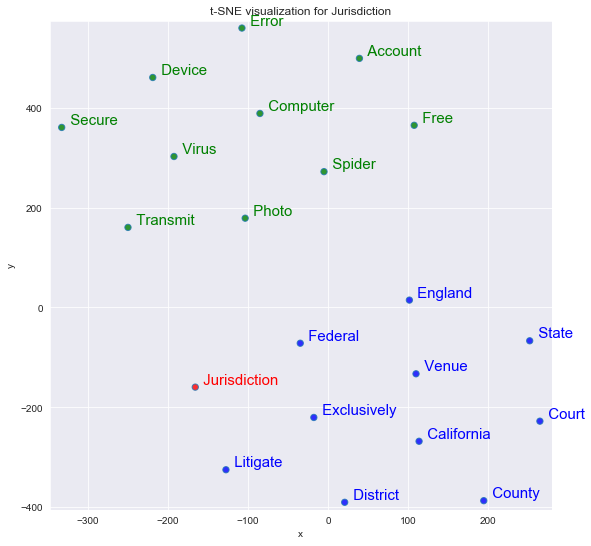

In [30]:
tsnescatterplot(w2v_model, 'jurisdiction', [i[0] for i in w2v_model.wv.most_similar(negative=["jurisdiction"])])

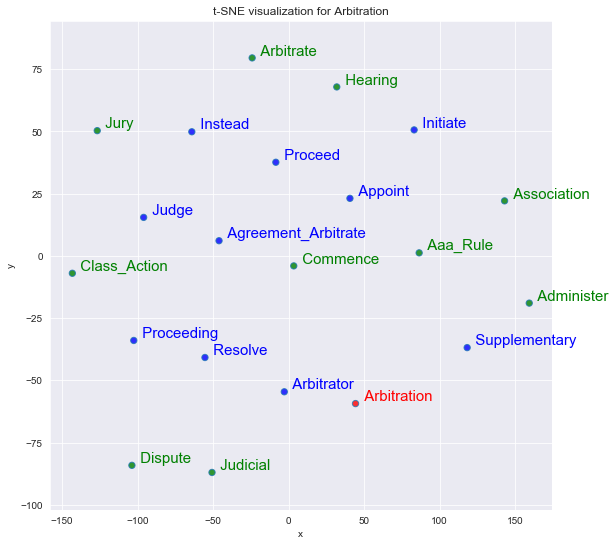

In [31]:
tsnescatterplot(w2v_model, "arbitration", [t[0] for t in w2v_model.wv.most_similar(positive=["arbitration"], topn=20)][10:])

In [32]:
w2v_model.wv.save_word2vec_format('../models/w2v_fair_model.bin', binary=True)

INFO - 13:45:57: storing 1215x300 projection weights into ../models/w2v_fair_model.bin
